# *What Makes a Good Starbucks in Los Angeles?*

## Applied Data Science Capstone project - The Battle of Neighborhoods


## Table of Contents

<div class="alert alert-block alert-info" style="margin-top: 20px">

1. [Introduction: Business Problem](#0)<br>
2. [Data](#2)<br>
2a [Get list of postal codes in Los Angeles County](#4)<br>
2b [Get list of Starbucks by postal code](#6) <br>
2c [Pull venue details including rating](#8)<br>
2d [Find neighbor categories](#10)<br>
2e [Extract venue attributes](#12)<br>
2f [Calculate distance to the nearest Starbucks](#14)<br>
3. [Methodology](#16)<br>
3a [Data exploration and visualization](#18)<br>
4. [Results](#20)<br>
4a [Create multiple regression model to predict rating](#22)<br>
5. [Discussion](#24)<br>
5a [Model summary](#26)<br>
5b [Observations](#28)<br>
6. [Conclusion](#30)<br>
6a [Recommendations](#32)<br>
6b [Further Analysis](#34)<br>
    
    

</div>
<hr>

# Introduction: Business Problem <a id="0"></a>
There are 966 Starbucks venues in Los Angeles County, and there is a wide range of Foursquare ratings across them.
This analysis attempts to identify features that drive a high or low rating using correlation analysis and linear regression.

Proposed features include:
1. Venue attributes
2. Neighbor categories
3. Distance to the nearest Starbucks

The results of this report would be very valuable for:
- Owners of existing Starbucks stores in Los Angeles
- Someone who is considering opening a new Starbucks location in Los Angeles


## Import libraries <a id="0"></a>

In [2]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

!conda install -c conda-forge geopy --yes
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

!conda install -c conda-forge folium=0.5.0 --yes
import folium # map rendering library

!conda install -c conda-forge tabula-py
import tabula

!conda install -c conda-forge geocoder --yes
import geocoder # import geocoder

print('Libraries imported.')

Solving environment: done

## Package Plan ##

  environment location: /opt/conda/envs/Python36

  added / updated specs: 
    - geopy


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    certifi-2019.11.28         |           py36_0         149 KB  conda-forge
    geographiclib-1.50         |             py_0          34 KB  conda-forge
    geopy-1.20.0               |             py_0          57 KB  conda-forge
    openssl-1.1.1d             |       h516909a_0         2.1 MB  conda-forge
    ca-certificates-2019.11.28 |       hecc5488_0         145 KB  conda-forge
    ------------------------------------------------------------
                                           Total:         2.5 MB

The following NEW packages will be INSTALLED:

    geographiclib:   1.50-py_0         conda-forge
    geopy:           1.20.0-py_0       conda-forge

The following packages will be UPDATED:

    ca-

# Data <a id="2"></a>
Gather data for potential features:  

- Venue attributes
- Neighbor categories
- Distance to the nearest Starbucks

## Get list of postal codes in Los Angeles County <a id="4"></a>

Get list of postal codes for LA county and create a dataframe

In [3]:
file = "http://file.lacounty.gov/SDSInter/lac/1031552_MasterZipCodes.pdf"
table_list = tabula.read_pdf(file, pages = "all", multiple_tables = True)
#LA_zip_codes = LA_zip_codes[0]
LA_zip_codes = pd.concat(table_list)
LA_zip_codes = LA_zip_codes[0]
LA_zip_codes.dropna(inplace=True)
LA_zip_codes = LA_zip_codes[LA_zip_codes.str.startswith('9')]
LA_zip_codes = LA_zip_codes.reset_index(drop=True)
LA_zip_codes = LA_zip_codes.str.split(' ', 1, expand=True)
LA_zip_codes.columns = ['Zip_code', 'Area_name']
LA_zip_codes.shape[0]

487

In [4]:
LA_zip_codes.tail(20)

,Zip_code,Area_name
467,93243,Lebec
468,93510,Acton
469,93523,Edwards AFB
470,93532,Elizabeth Lake/Lake Hughes
471,93534,Lancaster
472,93535,Hi Vista
473,93536,Lancaster/Quartz Hill
474,93539,Lancaster
475,93543,Littlerock/Juniper Hills
476,93544,Llano


In [5]:
# Use the geocoder to get latitude longitude for each Zip Code

latitude = []
longitude = []

for row in LA_zip_codes['Zip_code']:

    # initialize your variable to None
    lat_lng_coords = None
    g = geocoder.arcgis('{}'.format(row))
    lat_lng_coords = g.latlng
    latitude.append(lat_lng_coords[0])
    longitude.append(lat_lng_coords[1])

LA_zip_codes["Latitude"] = latitude
LA_zip_codes["Longitude"] = longitude
LA_zip_codes.head()


,Zip_code,Area_name,Latitude,Longitude
0,90001,Florence/South Central (City of LA),33.973630,-118.249890
1,90002,Watts (City of LA),33.948260,-118.247175
2,90003,South Central (City of LA),33.964340,-118.273890
3,90004,Hancock Park (City of LA),34.076235,-118.310820
4,90005,Koreatown (City of LA),34.059650,-118.322015


In [7]:
LA_zip_codes.tail(20)

,Zip_code,Area_name,Latitude,Longitude
467,93243,Lebec,34.778067,-118.791026
468,93510,Acton,34.435818,-118.191748
469,93523,Edwards AFB,35.011900,-117.876800
470,93532,Elizabeth Lake/Lake Hughes,34.718429,-118.577733
471,93534,Lancaster,34.689435,-118.150350
472,93535,Hi Vista,34.719512,-117.902445
473,93536,Lancaster/Quartz Hill,34.718759,-118.366616
474,93539,Lancaster,34.678815,-118.165654
475,93543,Littlerock/Juniper Hills,34.521150,-117.972225
476,93544,Llano,34.487660,-117.765135


In [10]:
#project.save_data(data=LA_zip_codes.to_csv(index=False),file_name='LA_zip_codes.csv',overwrite=True)

{'file_name': 'LA_cip_codes.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'courseracapstone-donotdelete-pr-uviyjrmv63dp01',
 'asset_id': '620c84fa-3a3e-4459-8942-19f57049abf0'}

In [3]:
# read LA_zip_codes.csv into dataframe (instead of building over again)
my_file = project.get_file('LA_zip_codes.csv')
my_file.seek(0)
LA_zip_codes = pd.read_csv(my_file)
LA_zip_codes.head()

,Zip_code,Area_name,Latitude,Longitude
0,90001,Florence/South Central (City of LA),33.973630,-118.249890
1,90002,Watts (City of LA),33.948260,-118.247175
2,90003,South Central (City of LA),33.964340,-118.273890
3,90004,Hancock Park (City of LA),34.076235,-118.310820
4,90005,Koreatown (City of LA),34.059650,-118.322015


In [4]:
LA_zip_codes.shape

(487, 4)

In [4]:
# Get the geographical coordinates of Los Angeles
address = 'Los Angeles, CA'

geolocator = Nominatim(user_agent="la_explorer")
location = geolocator.geocode(address)
latitude_la = location.latitude
longitude_la = location.longitude
print('The geograpical coordinate of Los Angeles are {}, {}.'.format(latitude_la, longitude_la))

The geograpical coordinate of Los Angeles are 34.0536909, -118.2427666.


In [5]:
# create map of Los Angeles using latitude and longitude values
map_la = folium.Map(location=[latitude_la, longitude_la], zoom_start=10)

# add markers to map
for lat, lng, label in zip(LA_zip_codes['Latitude'], LA_zip_codes['Longitude'], LA_zip_codes['Zip_code']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_la)  
    
map_la

## Get list of Starbucks by postal code <a id="6"></a>

In [6]:
CLIENT_ID = 'XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX' # your Foursquare ID
CLIENT_SECRET = 'XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX' # your Foursquare Secret
VERSION = '20200109' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
CLIENT_SECRET:XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX


In [7]:
# Find all Starbucks by searching each zip code for nearby locations
nearby_venues_by_zip = pd.DataFrame()
LIMIT = 100
CATEGORY_ID = '4bf58dd8d48988d1e0931735' # Coffee shops
radius = 4024 # 4024 meters equals 2.5 miles so search circle is 5 miles across
query = 'Starbucks'

for lat, lng in zip(LA_zip_codes['Latitude'], LA_zip_codes['Longitude']):
    url = 'https://api.foursquare.com/v2/venues/search?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}&query={}'.format(CLIENT_ID, CLIENT_SECRET, VERSION, lat, lng, radius, LIMIT, CATEGORY_ID, query)
    results = requests.get(url).json()
    venues = results['response']['venues']
    nearby_venues = json_normalize(venues) # flatten JSON
    if nearby_venues.dropna().empty == False:
        # filter columns
        filtered_columns = ['id', 'location.address', 'location.city','location.lat', 'location.lng', 'location.postalCode', 'name']
        nearby_venues = nearby_venues.loc[:, filtered_columns]
        # clean columns
        nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]
        nearby_venues_by_zip = nearby_venues_by_zip.append(nearby_venues)

nearby_venues_by_zip.reset_index(drop=True, inplace=True)
nearby_venues_by_zip.head()

/opt/conda/envs/Python36/lib/python3.6/site-packages/pandas/core/indexing.py:1494: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


,id,address,city,lat,lng,postalCode,name
0,4b6c4a47f964a5203c2e2ce3,1437 E Gage Ave,Los Angeles,33.982308,-118.248928,90001,Starbucks
1,4be1798cd4c362b55905f9ec,6021 Pacific Blvd.,Huntington Park,33.986978,-118.225497,90255,Starbucks
2,4b2e9f09f964a520bde324e3,8924 Long Beach Blvd,Southgate,33.955221,-118.219168,90280,Starbucks
3,4b50c5bef964a520c93127e3,3060 E. Slauson Ave.,Huntington Park,33.988958,-118.213739,90255,Starbucks
4,534ef1cb498ece5bf501ed25,5857 S. Central Ave.,Los Angeles,33.987890,-118.257179,90001,Starbucks


In [8]:
nearby_venues_by_zip.shape

(8335, 7)

In [11]:
# Delete duplicates that were found in overlapping search areas
starbucks_venues = nearby_venues_by_zip.drop_duplicates()
print('shape = ',starbucks_venues.shape)
starbucks_venues['id'].value_counts().head()

shape =  (967, 7)


584746222ec364019857a965    1
54f4de8b498e094d2b12930f    1
4fc7bff9e4b02d26a50a0be6    1
4a80aa20f964a520daf51fe3    1
50c36d5ee4b0309a642ad8bc    1
Name: id, dtype: int64

In [12]:
starbucks_venues.head()

,id,address,city,lat,lng,postalCode,name
0,4b6c4a47f964a5203c2e2ce3,1437 E Gage Ave,Los Angeles,33.982308,-118.248928,90001,Starbucks
1,4be1798cd4c362b55905f9ec,6021 Pacific Blvd.,Huntington Park,33.986978,-118.225497,90255,Starbucks
2,4b2e9f09f964a520bde324e3,8924 Long Beach Blvd,Southgate,33.955221,-118.219168,90280,Starbucks
3,4b50c5bef964a520c93127e3,3060 E. Slauson Ave.,Huntington Park,33.988958,-118.213739,90255,Starbucks
4,534ef1cb498ece5bf501ed25,5857 S. Central Ave.,Los Angeles,33.987890,-118.257179,90001,Starbucks


In [13]:
starbucks_venues.sort_values(['postalCode','id'], ascending = True, inplace=True)
starbucks_venues.reset_index(drop=True, inplace=True)
starbucks_venues.shape

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


(967, 7)

In [14]:
starbucks_venues.head()

,id,address,city,lat,lng,postalCode,name
0,4b6c4a47f964a5203c2e2ce3,1437 E Gage Ave,Los Angeles,33.982308,-118.248928,90001,Starbucks
1,534ef1cb498ece5bf501ed25,5857 S. Central Ave.,Los Angeles,33.987890,-118.257179,90001,Starbucks
2,4a0339a0f964a520a2711fe3,206 N Larchmont Blvd,Los Angeles,34.074910,-118.323460,90004,Starbucks
3,5d98e459bee77800074996a5,181 S Vermont Ave,Los Angeles,34.070772,-118.292059,90004,Starbucks
4,4acf467bf964a520f6d220e3,3303 S Hoover St,Los Angeles,34.024969,-118.284189,90007,Starbucks


In [15]:
#project.save_data(data=starbucks_venues.to_csv(index=False),file_name='starbucks_venues.csv',overwrite=True)

{'file_name': 'starbucks_venues.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'courseracapstone-donotdelete-pr-uviyjrmv63dp01',
 'asset_id': 'a6b18c88-d106-438e-8a51-478a8cd5bd98'}

In [7]:
# Read starbucks_venues from csv
my_file = project.get_file('starbucks_venues.csv')
my_file.seek(0)
starbucks_venues = pd.read_csv(my_file)
starbucks_venues.head()

,id,address,city,lat,lng,postalCode,name
0,4b6c4a47f964a5203c2e2ce3,1437 E Gage Ave,Los Angeles,33.982308,-118.248928,90001,Starbucks
1,534ef1cb498ece5bf501ed25,5857 S. Central Ave.,Los Angeles,33.987890,-118.257179,90001,Starbucks
2,4a0339a0f964a520a2711fe3,206 N Larchmont Blvd,Los Angeles,34.074910,-118.323460,90004,Starbucks
3,5d98e459bee77800074996a5,181 S Vermont Ave,Los Angeles,34.070772,-118.292059,90004,Starbucks
4,4acf467bf964a520f6d220e3,3303 S Hoover St,Los Angeles,34.024969,-118.284189,90007,Starbucks


In [8]:
starbucks_venues.shape

(967, 7)

In [8]:
# Draw a map of all Starbucks in LA

# create map of Los Angeles using latitude and longitude values
map_la = folium.Map(location=[latitude_la, longitude_la], zoom_start=10)

# add markers to map
for lat, lng, label in zip(starbucks_venues['lat'], starbucks_venues['lng'], starbucks_venues['postalCode']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_la)  
    
map_la

## Pull venue details including rating <a id="8"></a>

In [10]:
# WATCH OUT FOR DAILY LIMITS HERE (LIMITED TO 500 QUERIES PER DAY)
# Pull venue details for each Starbucks including rating

starbucks_venue_details = pd.DataFrame()

#starbucks_venues_H1 = starbucks_venues[0:484]
starbucks_venues_H2 = starbucks_venues[484:]

for id in (starbucks_venues_H2['id']):
    url = 'https://api.foursquare.com/v2/venues/{}?&client_id={}&client_secret={}&v={}'.format(id, CLIENT_ID, CLIENT_SECRET, VERSION)
    results = requests.get(url).json()
    venue_details_json = results['response']['venue']
    venue_details = json_normalize(venue_details_json) # flatten JSON
    if venue_details.dropna().empty == False:
        # filter columns
        filtered_columns = ['attributes.groups','description','id','likes.count','photos.count','price.message','price.tier','rating','ratingSignals','stats.tipCount']
        venue_details = venue_details.loc[:, filtered_columns]
        starbucks_venue_details = starbucks_venue_details.append(venue_details)

starbucks_venue_details.reset_index(drop=True, inplace=True)
starbucks_venue_details.head()

/opt/conda/envs/Python36/lib/python3.6/site-packages/pandas/core/indexing.py:1494: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


,attributes.groups,description,id,likes.count,photos.count,price.message,price.tier,rating,ratingSignals,stats.tipCount
0,"[{'type': 'price', 'name': 'Price', 'summary':...",NaN,56f81fba498e910d50585e58,0,0,Cheap,1,7.2,0.0,0
1,"[{'type': 'price', 'name': 'Price', 'summary':...",Long Beach Towne Center,4b50e2edf964a520fd3627e3,56,78,Moderate,2,7.4,88.0,31
2,"[{'type': 'price', 'name': 'Price', 'summary':...",Pavilions-Long Beach #2203,4b649373f964a52008bf2ae3,13,35,Cheap,1,5.9,26.0,12
3,"[{'type': 'price', 'name': 'Price', 'summary':...",NaN,4f453ca619836ed00199709b,0,0,Cheap,1,NaN,NaN,0
4,"[{'type': 'price', 'name': 'Price', 'summary':...",Lakewood & Cover,51dc1104498e71fbaaf2d500,66,37,Cheap,1,7.6,93.0,9


In [11]:
#project.save_data(data=starbucks_venue_details.to_csv(index=False),file_name='starbucks_venue_details_H2.csv',overwrite=True)

{'file_name': 'starbucks_venue_details_H2.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'courseracapstone-donotdelete-pr-uviyjrmv63dp01',
 'asset_id': 'f88fd657-0a04-4f41-aca8-8ef55e45c2d4'}

In [9]:
# Read starbucks_venue_details_H1 from csv
my_file = project.get_file('starbucks_venue_details_H1.csv')
my_file.seek(0)
starbucks_venue_details_H1 = pd.read_csv(my_file)
starbucks_venue_details_H1.head()

# Read starbucks_venue_details_H2 from csv
my_file = project.get_file('starbucks_venue_details_H2.csv')
my_file.seek(0)
starbucks_venue_details_H2 = pd.read_csv(my_file)
starbucks_venue_details_H2.head()

# Concatenate starbucks_venue_details_H1 & starbucks_venue_details_H2
frames = [starbucks_venue_details_H1, starbucks_venue_details_H2]
starbucks_venue_details = pd.concat(frames)

# Delete duplicates
starbucks_venue_details = starbucks_venue_details.drop_duplicates()

starbucks_venue_details.sort_values(['id'], ascending = True, inplace=True)
starbucks_venue_details.reset_index(drop=True, inplace=True)

print('shape = ',starbucks_venue_details.shape)
starbucks_venue_details.head()

shape =  (966, 10)


,attributes.groups,description,id,likes.count,photos.count,price.message,price.tier,rating,ratingSignals,stats.tipCount
0,"[{'type': 'price', 'name': 'Price', 'summary':...",Woodland Hills,40870b00f964a520b5f21ee3,64,67,Cheap,1.0,8.2,93.0,22
1,"[{'type': 'price', 'name': 'Price', 'summary':...",Victory & Canoga - Woodland Hills,40a40c00f964a52013f31ee3,67,78,Moderate,2.0,7.3,107.0,22
2,"[{'type': 'price', 'name': 'Price', 'summary':...",Western & Slauson,40d62500f964a5204a011fe3,41,56,Cheap,1.0,5.9,77.0,27
3,"[{'type': 'price', 'name': 'Price', 'summary':...",Cerritos,40e9eb80f964a5201b0a1fe3,52,81,Cheap,1.0,7.1,75.0,58
4,"[{'type': 'price', 'name': 'Price', 'summary':...",Beverly Hills Triangle,4158a980f964a5203d1d1fe3,134,169,Cheap,1.0,8.1,185.0,31


In [10]:
# Merge starbucks_venues with starbucks_venue_details 
starbucks_master = pd.merge(starbucks_venues,starbucks_venue_details,how='inner',on='id')
starbucks_master.head()

,id,address,city,lat,lng,postalCode,name,attributes.groups,description,likes.count,photos.count,price.message,price.tier,rating,ratingSignals,stats.tipCount
0,4b6c4a47f964a5203c2e2ce3,1437 E Gage Ave,Los Angeles,33.982308,-118.248928,90001,Starbucks,"[{'type': 'price', 'name': 'Price', 'summary':...","Gage & Compton, Huntington Park",28,22,Moderate,2.0,6.0,52.0,17
1,534ef1cb498ece5bf501ed25,5857 S. Central Ave.,Los Angeles,33.987890,-118.257179,90001,Starbucks,"[{'type': 'price', 'name': 'Price', 'summary':...",NaN,21,10,Cheap,1.0,7.8,25.0,0
2,4a0339a0f964a520a2711fe3,206 N Larchmont Blvd,Los Angeles,34.074910,-118.323460,90004,Starbucks,"[{'type': 'price', 'name': 'Price', 'summary':...",Hancock Park,44,98,Moderate,2.0,7.1,72.0,23
3,5d98e459bee77800074996a5,181 S Vermont Ave,Los Angeles,34.070772,-118.292059,90004,Starbucks,"[{'type': 'price', 'name': 'Price', 'summary':...",NaN,0,1,Cheap,1.0,7.2,0.0,0
4,4acf467bf964a520f6d220e3,3303 S Hoover St,Los Angeles,34.024969,-118.284189,90007,Starbucks,"[{'type': 'price', 'name': 'Price', 'summary':...",Hoover & Jefferson,31,75,Cheap,1.0,5.6,76.0,33


In [11]:
starbucks_master.shape

(966, 16)

In [12]:
# Draw a map of all Starbucks in LA with a rating

# create map of Los Angeles using latitude and longitude values
map_la = folium.Map(location=[latitude_la, longitude_la], zoom_start=10)

# add markers to map
for lat, lng, label in zip(starbucks_master['lat'], starbucks_master['lng'], starbucks_master['rating']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_la)  
    
map_la

## Find neighbor categories <a id="10"></a>

Look for the nearest 5 venues for each Starbucks and identify the venue category

In [27]:
starbucks_neighbor_venues = pd.DataFrame()
LIMIT = 6 # Pulling 5 closest venues plus the origin Starbucks venue itself
radius = 80 # 80 meters equals 0.05 mile radius to get immediate neighbors
intent = 'browse'

for lat, lng, id_origin in zip(starbucks_master['lat'], starbucks_master['lng'], starbucks_master['id']):
    url = 'https://api.foursquare.com/v2/venues/search?&client_id={}&client_secret={}&v={}&ll={},{}&intent={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, VERSION, lat, lng, intent, radius, LIMIT)
    results = requests.get(url).json()
    neighbor_venues_json = results['response']['venues']
    neighbor_venues = json_normalize(neighbor_venues_json) # flatten JSON
    # Create new columns
    neighbor_venues['id_origin'] = id_origin
    neighbor_venues['category_id'] = neighbor_venues.apply(lambda row: row['categories'][0]['id'] if len(row['categories']) > 0 else np.nan, axis=1)
    neighbor_venues['category_name'] = neighbor_venues.apply(lambda row: row['categories'][0]['name'] if len(row['categories']) > 0 else np.nan, axis=1)
    if neighbor_venues.dropna().empty == False:
        # filter columns
        filtered_columns = ['id_origin', 'id', 'name', 'category_id', 'category_name', 'location.address', 'location.city','location.lat', 'location.lng', 'location.postalCode']
        neighbor_venues = neighbor_venues.loc[:, filtered_columns]
        # remove the origin Starbucks location
        neighbor_venues = neighbor_venues[neighbor_venues['id_origin'] != neighbor_venues['id']]
        # append to combined results table
        starbucks_neighbor_venues = starbucks_neighbor_venues.append(neighbor_venues)

starbucks_neighbor_venues.reset_index(drop=True, inplace=True)
starbucks_neighbor_venues.head()

,id_origin,id,name,category_id,category_name,location.address,location.city,location.lat,location.lng,location.postalCode
0,4a0339a0f964a520a2711fe3,4a5cecc3f964a520debc1fe3,Larchmont Village Wine & Cheese,4bf58dd8d48988d1c5941735,Sandwich Place,223 N Larchmont Blvd,Los Angeles,34.075327,-118.323704,90004
1,4a0339a0f964a520a2711fe3,5ad673fb73fe2534909fb70d,Groundwork Coffee Co.,4bf58dd8d48988d1e0931735,Coffee Shop,150 N Larchmont Blvd,Los Angeles,34.074531,-118.323607,90004
2,4a0339a0f964a520a2711fe3,4a6cba98f964a52074d11fe3,Flicka,4bf58dd8d48988d105951735,Kids Store,204 N Larchmont Blvd,Los Angeles,34.074769,-118.323371,90004
3,4a0339a0f964a520a2711fe3,4cf7da9064e3721e3ae328c8,Larchmont Beauty Center,4bf58dd8d48988d110951735,Salon / Barbershop,208 N Larchmont Blvd,Los Angeles,34.075030,-118.323529,90004
4,4a0339a0f964a520a2711fe3,4ba98a8ff964a520822d3ae3,Above The Fold,4bf58dd8d48988d1ff941735,Miscellaneous Shop,226 N Larchmont Blvd,Los Angeles,34.075442,-118.323636,90004


In [28]:
starbucks_neighbor_venues.shape

(3264, 10)

In [29]:
#project.save_data(data=starbucks_neighbor_venues.to_csv(index=False),file_name='starbucks_neighbor_venues.csv',overwrite=True)

{'file_name': 'starbucks_neighbor_venues.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'courseracapstone-donotdelete-pr-uviyjrmv63dp01',
 'asset_id': 'f34fe172-920a-4780-8dde-a47ad1310e26'}

In [14]:
# Read starbucks_neighbor_venues from csv
my_file = project.get_file('starbucks_neighbor_venues.csv')
my_file.seek(0)
starbucks_neighbor_venues = pd.read_csv(my_file)
starbucks_neighbor_venues.head()

,id_origin,id,name,category_id,category_name,location.address,location.city,location.lat,location.lng,location.postalCode
0,4a0339a0f964a520a2711fe3,4a5cecc3f964a520debc1fe3,Larchmont Village Wine & Cheese,4bf58dd8d48988d1c5941735,Sandwich Place,223 N Larchmont Blvd,Los Angeles,34.075327,-118.323704,90004
1,4a0339a0f964a520a2711fe3,5ad673fb73fe2534909fb70d,Groundwork Coffee Co.,4bf58dd8d48988d1e0931735,Coffee Shop,150 N Larchmont Blvd,Los Angeles,34.074531,-118.323607,90004
2,4a0339a0f964a520a2711fe3,4a6cba98f964a52074d11fe3,Flicka,4bf58dd8d48988d105951735,Kids Store,204 N Larchmont Blvd,Los Angeles,34.074769,-118.323371,90004
3,4a0339a0f964a520a2711fe3,4cf7da9064e3721e3ae328c8,Larchmont Beauty Center,4bf58dd8d48988d110951735,Salon / Barbershop,208 N Larchmont Blvd,Los Angeles,34.075030,-118.323529,90004
4,4a0339a0f964a520a2711fe3,4ba98a8ff964a520822d3ae3,Above The Fold,4bf58dd8d48988d1ff941735,Miscellaneous Shop,226 N Larchmont Blvd,Los Angeles,34.075442,-118.323636,90004


Convert neighbor venue categories into one-hot dummies

In [15]:
starbucks_neighbor_venues['category_name_for_dummies']=starbucks_neighbor_venues['category_name']
starbucks_neighbor_venues.drop(columns=['id','name','category_id','category_name','location.address','location.city','location.lat','location.lng','location.postalCode'], inplace=True)
starbucks_neighbor_venues.head()

,id_origin,category_name_for_dummies
0,4a0339a0f964a520a2711fe3,Sandwich Place
1,4a0339a0f964a520a2711fe3,Coffee Shop
2,4a0339a0f964a520a2711fe3,Kids Store
3,4a0339a0f964a520a2711fe3,Salon / Barbershop
4,4a0339a0f964a520a2711fe3,Miscellaneous Shop


In [16]:
starbucks_neighbor_venues_onehot = pd.get_dummies(starbucks_neighbor_venues,columns=['category_name_for_dummies'], prefix="", prefix_sep="", drop_first=True)
starbucks_neighbor_venues_onehot.head()

,id_origin,Accessories Store,Acupuncturist,Advertising Agency,Airport,Airport Gate,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Stadium,Beach,Beer Bar,Big Box Store,Bike Shop,Board Shop,Boarding House,Boat or Ferry,Bookstore,Border Crossing,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Buffet,Building,Burger Joint,Bus Line,Bus Station,Bus Stop,Business Center,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Car Wash,Casino,Cemetery,Check Cashing Service,Cheese Shop,Chinese Restaurant,Chiropractor,Church,City Hall,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Administrative Building,College Auditorium,College Baseball Diamond,College Basketball Court,College Bookstore,College Cafeteria,College Classroom,College Engineering Building,College Gym,College Lab,College Library,College Quad,College Rec Center,College Residence Hall,College Science Building,College Theater,Comfort Food Restaurant,Comic Shop,Community College,Concert Hall,Conference Room,Construction & Landscaping,Convenience Store,Convention Center,Corporate Cafeteria,Corporate Coffee Shop,Cosmetics Shop,Courthouse,Coworking Space,Credit Union,Cruise,Cultural Center,Cycle Studio,Dance Studio,Daycare,Deli / Bodega,Dentist's Office,Department Store,Design Studio,Dessert Shop,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donburi Restaurant,Doner Restaurant,Donut Shop,Dry Cleaner,Dumpling Restaurant,EV Charging Station,Electronics Store,Elementary School,Emergency Room,Event Space,Eye Doctor,Fabric Shop,Farm,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Film Studio,Financial or Legal Service,Fire Station,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,Fraternity House,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,General College & University,General Entertainment,General Travel,Gift Shop,Golf Course,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gymnastics Gym,Halal Restaurant,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Historic Site,Hobby Shop,Home Service,Hospital,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Housing Development,Ice Cream Shop,Indian Restaurant,Intersection,Irish Pub,Island,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Laboratory,Lake,Latin American Restaurant,Laundry Service,Lawyer,Library,Light Rail Station,Lighting Store,Lingerie Store,Liquor Store,Locksmith,Lounge,Market,Martial Arts Dojo,Massage Studio,Maternity Clinic,Medical Center,Medical Lab,Medical School,Mediterranean Restaurant,Meeting Room,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Military Base,Miscellaneous Shop,Mobile Phone Shop,Moroccan Restaurant,Motel,Mountain,Movie Theater,Moving Target,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,New American Restaurant,Night Market,Nightclub,Nightlife Spot,Non-Profit,Noodle House,Nudist Beach,Nursery School,Office,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Paper / Office Supplies Store,Park,Parking,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Lab,Physical Therapist,Pier,Piercing Parlor,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Port,Post Office,Pub,Public Art,Racetrack,Ramen Restaurant,Recycling Facility,Rental Car Location,Rental Service,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,Road,Sake Bar,Salad Place,Salon / Barbershop,Sandwi

In [17]:
starbucks_neighbor_venues_categories = starbucks_neighbor_venues_onehot.groupby('id_origin').max().reset_index()
starbucks_neighbor_venues_categories.rename(columns={"id_origin": "id"}, inplace=True)
starbucks_neighbor_venues_categories.head()

,id,Accessories Store,Acupuncturist,Advertising Agency,Airport,Airport Gate,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Stadium,Beach,Beer Bar,Big Box Store,Bike Shop,Board Shop,Boarding House,Boat or Ferry,Bookstore,Border Crossing,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Buffet,Building,Burger Joint,Bus Line,Bus Station,Bus Stop,Business Center,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Car Wash,Casino,Cemetery,Check Cashing Service,Cheese Shop,Chinese Restaurant,Chiropractor,Church,City Hall,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Administrative Building,College Auditorium,College Baseball Diamond,College Basketball Court,College Bookstore,College Cafeteria,College Classroom,College Engineering Building,College Gym,College Lab,College Library,College Quad,College Rec Center,College Residence Hall,College Science Building,College Theater,Comfort Food Restaurant,Comic Shop,Community College,Concert Hall,Conference Room,Construction & Landscaping,Convenience Store,Convention Center,Corporate Cafeteria,Corporate Coffee Shop,Cosmetics Shop,Courthouse,Coworking Space,Credit Union,Cruise,Cultural Center,Cycle Studio,Dance Studio,Daycare,Deli / Bodega,Dentist's Office,Department Store,Design Studio,Dessert Shop,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donburi Restaurant,Doner Restaurant,Donut Shop,Dry Cleaner,Dumpling Restaurant,EV Charging Station,Electronics Store,Elementary School,Emergency Room,Event Space,Eye Doctor,Fabric Shop,Farm,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Film Studio,Financial or Legal Service,Fire Station,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,Fraternity House,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,General College & University,General Entertainment,General Travel,Gift Shop,Golf Course,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gymnastics Gym,Halal Restaurant,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Historic Site,Hobby Shop,Home Service,Hospital,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Housing Development,Ice Cream Shop,Indian Restaurant,Intersection,Irish Pub,Island,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Laboratory,Lake,Latin American Restaurant,Laundry Service,Lawyer,Library,Light Rail Station,Lighting Store,Lingerie Store,Liquor Store,Locksmith,Lounge,Market,Martial Arts Dojo,Massage Studio,Maternity Clinic,Medical Center,Medical Lab,Medical School,Mediterranean Restaurant,Meeting Room,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Military Base,Miscellaneous Shop,Mobile Phone Shop,Moroccan Restaurant,Motel,Mountain,Movie Theater,Moving Target,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,New American Restaurant,Night Market,Nightclub,Nightlife Spot,Non-Profit,Noodle House,Nudist Beach,Nursery School,Office,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Paper / Office Supplies Store,Park,Parking,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Lab,Physical Therapist,Pier,Piercing Parlor,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Port,Post Office,Pub,Public Art,Racetrack,Ramen Restaurant,Recycling Facility,Rental Car Location,Rental Service,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,Road,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Plac

In [18]:
starbucks_neighbor_venues_categories.shape

(637, 343)

In [19]:
# Merge starbucks_venues with starbucks_venue_details 
starbucks_master_02 = pd.merge(starbucks_master,starbucks_neighbor_venues_categories,how='left',on='id')
starbucks_master_02.head()

,id,address,city,lat,lng,postalCode,name,attributes.groups,description,likes.count,photos.count,price.message,price.tier,rating,ratingSignals,stats.tipCount,Accessories Store,Acupuncturist,Advertising Agency,Airport,Airport Gate,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Stadium,Beach,Beer Bar,Big Box Store,Bike Shop,Board Shop,Boarding House,Boat or Ferry,Bookstore,Border Crossing,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Buffet,Building,Burger Joint,Bus Line,Bus Station,Bus Stop,Business Center,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Car Wash,Casino,Cemetery,Check Cashing Service,Cheese Shop,Chinese Restaurant,Chiropractor,Church,City Hall,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Administrative Building,College Auditorium,College Baseball Diamond,College Basketball Court,College Bookstore,College Cafeteria,College Classroom,College Engineering Building,College Gym,College Lab,College Library,College Quad,College Rec Center,College Residence Hall,College Science Building,College Theater,Comfort Food Restaurant,Comic Shop,Community College,Concert Hall,Conference Room,Construction & Landscaping,Convenience Store,Convention Center,Corporate Cafeteria,Corporate Coffee Shop,Cosmetics Shop,Courthouse,Coworking Space,Credit Union,Cruise,Cultural Center,Cycle Studio,Dance Studio,Daycare,Deli / Bodega,Dentist's Office,Department Store,Design Studio,Dessert Shop,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donburi Restaurant,Doner Restaurant,Donut Shop,Dry Cleaner,Dumpling Restaurant,EV Charging Station,Electronics Store,Elementary School,Emergency Room,Event Space,Eye Doctor,Fabric Shop,Farm,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Film Studio,Financial or Legal Service,Fire Station,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,Fraternity House,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,General College & University,General Entertainment,General Travel,Gift Shop,Golf Course,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gymnastics Gym,Halal Restaurant,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Historic Site,Hobby Shop,Home Service,Hospital,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Housing Development,Ice Cream Shop,Indian Restaurant,Intersection,Irish Pub,Island,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Laboratory,Lake,Latin American Restaurant,Laundry Service,Lawyer,Library,Light Rail Station,Lighting Store,Lingerie Store,Liquor Store,Locksmith,Lounge,Market,Martial Arts Dojo,Massage Studio,Maternity Clinic,Medical Center,Medical Lab,Medical School,Mediterranean Restaurant,Meeting Room,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Military Base,Miscellaneous Shop,Mobile Phone Shop,Moroccan Restaurant,Motel,Mountain,Movie Theater,Moving Target,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,New American Restaurant,Night Market,Nightclub,Nightlife Spot,Non-Profit,Noodle House,Nudist Beach,Nursery School,Office,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Paper / Office Supplies Store,Park,Parking,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Lab,Physical Therapist,Pier,Piercing Parlor,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Port,Post Office,Pub,Public Art,Racetrack,Ramen Restaurant,Recycling Facility,Rental Ca

In [20]:
starbucks_master_02.shape

(966, 358)

## Extract venue attributes <a id="12"></a>

In [21]:
attribute_groups=starbucks_master_02['attributes.groups'][1]
attribute_groups

"[{'type': 'price', 'name': 'Price', 'summary': '$', 'count': 1, 'items': [{'displayName': 'Price', 'displayValue': '$', 'priceTier': 1}]}, {'type': 'payments', 'name': 'Credit Cards', 'summary': 'Credit Cards', 'count': 7, 'items': [{'displayName': 'Credit Cards', 'displayValue': 'Yes'}]}, {'type': 'outdoorSeating', 'name': 'Outdoor Seating', 'summary': 'Outdoor Seating', 'count': 1, 'items': [{'displayName': 'Outdoor Seating', 'displayValue': 'Yes'}]}, {'type': 'music', 'name': 'Music', 'summary': 'Live Music', 'count': 3, 'items': [{'displayName': 'Live Music', 'displayValue': 'Live Music'}]}, {'type': 'wifi', 'name': 'Wi-Fi', 'summary': 'Wi-Fi', 'count': 1, 'items': [{'displayName': 'Wi-Fi', 'displayValue': 'Yes'}]}, {'type': 'serves', 'name': 'Menus', 'summary': 'Happy Hour, Brunch & more', 'count': 8, 'items': [{'displayName': 'Breakfast', 'displayValue': 'Breakfast'}, {'displayName': 'Brunch', 'displayValue': 'Brunch'}, {'displayName': 'Happy Hour', 'displayValue': 'Happy Hour'}

In [22]:
import ast

In [23]:
# Converts string to dictionary
res = ast.literal_eval(attribute_groups)
len(res)

7

In [24]:
# Extract list of attributes from 'attributes.groups' field
starbucks_attributes = pd.DataFrame()
for id, att in zip(starbucks_master_02['id'],starbucks_master_02['attributes.groups']):
    att_list = ast.literal_eval(att)
    for att_list_idx in range(len(att_list)):
        att_list_dict = att_list[att_list_idx]
        if 'summary' in att_list_dict:
            summary = att_list_dict['summary']
            attributes = pd.DataFrame({'id': [id], 'summary': [summary]})
            starbucks_attributes = starbucks_attributes.append(attributes)
            
starbucks_attributes.head()

,id,summary
0,4b6c4a47f964a5203c2e2ce3,$$
0,4b6c4a47f964a5203c2e2ce3,Credit Cards
0,4b6c4a47f964a5203c2e2ce3,Free Wi-Fi
0,534ef1cb498ece5bf501ed25,$
0,534ef1cb498ece5bf501ed25,Credit Cards


In [25]:
starbucks_attributes_onehot = pd.get_dummies(starbucks_attributes,columns=['summary'], prefix="", prefix_sep="", drop_first=True)
starbucks_attributes_onehot.head()

,id,$$,ATM,BYO,"Bar Service, Take-out & Drive-thru","Bar Snacks, Lunch & more",Beer,Beer & Wine,Breakfast,Breakfast & Brunch,Breakfast & Dessert,Breakfast & Happy Hour,Breakfast & Lunch,Brunch,Cocktails,Credit Cards,Delivery,"Dessert, Breakfast & more","Dessert, Brunch & more","Dessert, Dinner & more","Dessert, Lunch & more","Dinner, Breakfast & more","Dinner, Lunch & more",Drive-thru,Free Wi-Fi,Full Bar,Full Bar & Cocktails,Happy Hour,"Happy Hour, Breakfast & more","Happy Hour, Brunch & more",Jukebox,Live Music,"Lunch, Brunch & more",Music,No Credit Cards,Outdoor Seating,Parking,Private Lot,Public Lot,Reservations,Restroom,Street Parking,Street Parking & Private Lot,Street Parking & Public Lot,TVs,Take-out,Take-out & Drive-thru,Wheelchair Accessible,Wi-Fi,Wine
0,4b6c4a47f964a5203c2e2ce3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,4b6c4a47f964a5203c2e2ce3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,4b6c4a47f964a5203c2e2ce3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,534ef1cb498ece5bf501ed25,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,534ef1cb498ece5bf501ed25,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [26]:
starbucks_attributes_categories = starbucks_attributes_onehot.groupby('id').max().reset_index()
starbucks_attributes_categories.head()

,id,$$,ATM,BYO,"Bar Service, Take-out & Drive-thru","Bar Snacks, Lunch & more",Beer,Beer & Wine,Breakfast,Breakfast & Brunch,Breakfast & Dessert,Breakfast & Happy Hour,Breakfast & Lunch,Brunch,Cocktails,Credit Cards,Delivery,"Dessert, Breakfast & more","Dessert, Brunch & more","Dessert, Dinner & more","Dessert, Lunch & more","Dinner, Breakfast & more","Dinner, Lunch & more",Drive-thru,Free Wi-Fi,Full Bar,Full Bar & Cocktails,Happy Hour,"Happy Hour, Breakfast & more","Happy Hour, Brunch & more",Jukebox,Live Music,"Lunch, Brunch & more",Music,No Credit Cards,Outdoor Seating,Parking,Private Lot,Public Lot,Reservations,Restroom,Street Parking,Street Parking & Private Lot,Street Parking & Public Lot,TVs,Take-out,Take-out & Drive-thru,Wheelchair Accessible,Wi-Fi,Wine
0,40870b00f964a520b5f21ee3,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,40a40c00f964a52013f31ee3,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,40d62500f964a5204a011fe3,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
3,40e9eb80f964a5201b0a1fe3,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,4158a980f964a5203d1d1fe3,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0


In [29]:
# Merge starbucks_venues with starbucks_attributes_categories 
starbucks_master_03 = pd.merge(starbucks_master_02,starbucks_attributes_categories,how='left',on='id')
starbucks_master_03.head()

,id,address,city,lat,lng,postalCode,name,attributes.groups,description,likes.count,photos.count,price.message,price.tier,rating,ratingSignals,stats.tipCount,Accessories Store,Acupuncturist,Advertising Agency,Airport,Airport Gate,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Stadium,Beach,Beer Bar,Big Box Store,Bike Shop,Board Shop,Boarding House,Boat or Ferry,Bookstore,Border Crossing,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Buffet,Building,Burger Joint,Bus Line,Bus Station,Bus Stop,Business Center,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Car Wash,Casino,Cemetery,Check Cashing Service,Cheese Shop,Chinese Restaurant,Chiropractor,Church,City Hall,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Administrative Building,College Auditorium,College Baseball Diamond,College Basketball Court,College Bookstore,College Cafeteria,College Classroom,College Engineering Building,College Gym,College Lab,College Library,College Quad,College Rec Center,College Residence Hall,College Science Building,College Theater,Comfort Food Restaurant,Comic Shop,Community College,Concert Hall,Conference Room,Construction & Landscaping,Convenience Store,Convention Center,Corporate Cafeteria,Corporate Coffee Shop,Cosmetics Shop,Courthouse,Coworking Space,Credit Union,Cruise,Cultural Center,Cycle Studio,Dance Studio,Daycare,Deli / Bodega,Dentist's Office,Department Store,Design Studio,Dessert Shop,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donburi Restaurant,Doner Restaurant,Donut Shop,Dry Cleaner,Dumpling Restaurant,EV Charging Station,Electronics Store,Elementary School,Emergency Room,Event Space,Eye Doctor,Fabric Shop,Farm,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Film Studio,Financial or Legal Service,Fire Station,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,Fraternity House,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,General College & University,General Entertainment,General Travel,Gift Shop,Golf Course,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gymnastics Gym,Halal Restaurant,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Historic Site,Hobby Shop,Home Service,Hospital,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Housing Development,Ice Cream Shop,Indian Restaurant,Intersection,Irish Pub,Island,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Laboratory,Lake,Latin American Restaurant,Laundry Service,Lawyer,Library,Light Rail Station,Lighting Store,Lingerie Store,Liquor Store,Locksmith,Lounge,Market,Martial Arts Dojo,Massage Studio,Maternity Clinic,Medical Center,Medical Lab,Medical School,Mediterranean Restaurant,Meeting Room,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Military Base,Miscellaneous Shop,Mobile Phone Shop,Moroccan Restaurant,Motel,Mountain,Movie Theater,Moving Target,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,New American Restaurant,Night Market,Nightclub,Nightlife Spot,Non-Profit,Noodle House,Nudist Beach,Nursery School,Office,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Paper / Office Supplies Store,Park,Parking_x,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Lab,Physical Therapist,Pier,Piercing Parlor,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Port,Post Office,Pub,Public Art,Racetrack,Ramen Restaurant,Recycling Facility,Rental 

In [30]:
starbucks_master_03.shape

(966, 407)

In [31]:
#project.save_data(data=starbucks_master_03.to_csv(index=False),file_name='starbucks_master_03.csv',overwrite=True)

{'file_name': 'starbucks_master_03.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'courseracapstone-donotdelete-pr-uviyjrmv63dp01',
 'asset_id': 'a0624c54-4483-476e-8d12-e1695e312ea2'}

In [27]:
# Read starbucks_master_03 from csv
my_file = project.get_file('starbucks_master_03.csv')
my_file.seek(0)
starbucks_master_03 = pd.read_csv(my_file)
starbucks_master_03.head()

,id,address,city,lat,lng,postalCode,name,attributes.groups,description,likes.count,photos.count,price.message,price.tier,rating,ratingSignals,stats.tipCount,Accessories Store,Acupuncturist,Advertising Agency,Airport,Airport Gate,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Stadium,Beach,Beer Bar,Big Box Store,Bike Shop,Board Shop,Boarding House,Boat or Ferry,Bookstore,Border Crossing,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Buffet,Building,Burger Joint,Bus Line,Bus Station,Bus Stop,Business Center,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Car Wash,Casino,Cemetery,Check Cashing Service,Cheese Shop,Chinese Restaurant,Chiropractor,Church,City Hall,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Administrative Building,College Auditorium,College Baseball Diamond,College Basketball Court,College Bookstore,College Cafeteria,College Classroom,College Engineering Building,College Gym,College Lab,College Library,College Quad,College Rec Center,College Residence Hall,College Science Building,College Theater,Comfort Food Restaurant,Comic Shop,Community College,Concert Hall,Conference Room,Construction & Landscaping,Convenience Store,Convention Center,Corporate Cafeteria,Corporate Coffee Shop,Cosmetics Shop,Courthouse,Coworking Space,Credit Union,Cruise,Cultural Center,Cycle Studio,Dance Studio,Daycare,Deli / Bodega,Dentist's Office,Department Store,Design Studio,Dessert Shop,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donburi Restaurant,Doner Restaurant,Donut Shop,Dry Cleaner,Dumpling Restaurant,EV Charging Station,Electronics Store,Elementary School,Emergency Room,Event Space,Eye Doctor,Fabric Shop,Farm,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Film Studio,Financial or Legal Service,Fire Station,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,Fraternity House,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,General College & University,General Entertainment,General Travel,Gift Shop,Golf Course,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gymnastics Gym,Halal Restaurant,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Historic Site,Hobby Shop,Home Service,Hospital,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Housing Development,Ice Cream Shop,Indian Restaurant,Intersection,Irish Pub,Island,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Laboratory,Lake,Latin American Restaurant,Laundry Service,Lawyer,Library,Light Rail Station,Lighting Store,Lingerie Store,Liquor Store,Locksmith,Lounge,Market,Martial Arts Dojo,Massage Studio,Maternity Clinic,Medical Center,Medical Lab,Medical School,Mediterranean Restaurant,Meeting Room,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Military Base,Miscellaneous Shop,Mobile Phone Shop,Moroccan Restaurant,Motel,Mountain,Movie Theater,Moving Target,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,New American Restaurant,Night Market,Nightclub,Nightlife Spot,Non-Profit,Noodle House,Nudist Beach,Nursery School,Office,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Paper / Office Supplies Store,Park,Parking_x,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Lab,Physical Therapist,Pier,Piercing Parlor,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Port,Post Office,Pub,Public Art,Racetrack,Ramen Restaurant,Recycling Facility,Rental 

In [28]:
starbucks_venues['postalCode'].isnull().sum()

59

In [29]:
starbucks_master_03[starbucks_master_03['postalCode'].isnull()].head()

,id,address,city,lat,lng,postalCode,name,attributes.groups,description,likes.count,photos.count,price.message,price.tier,rating,ratingSignals,stats.tipCount,Accessories Store,Acupuncturist,Advertising Agency,Airport,Airport Gate,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Stadium,Beach,Beer Bar,Big Box Store,Bike Shop,Board Shop,Boarding House,Boat or Ferry,Bookstore,Border Crossing,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Buffet,Building,Burger Joint,Bus Line,Bus Station,Bus Stop,Business Center,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Car Wash,Casino,Cemetery,Check Cashing Service,Cheese Shop,Chinese Restaurant,Chiropractor,Church,City Hall,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Administrative Building,College Auditorium,College Baseball Diamond,College Basketball Court,College Bookstore,College Cafeteria,College Classroom,College Engineering Building,College Gym,College Lab,College Library,College Quad,College Rec Center,College Residence Hall,College Science Building,College Theater,Comfort Food Restaurant,Comic Shop,Community College,Concert Hall,Conference Room,Construction & Landscaping,Convenience Store,Convention Center,Corporate Cafeteria,Corporate Coffee Shop,Cosmetics Shop,Courthouse,Coworking Space,Credit Union,Cruise,Cultural Center,Cycle Studio,Dance Studio,Daycare,Deli / Bodega,Dentist's Office,Department Store,Design Studio,Dessert Shop,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donburi Restaurant,Doner Restaurant,Donut Shop,Dry Cleaner,Dumpling Restaurant,EV Charging Station,Electronics Store,Elementary School,Emergency Room,Event Space,Eye Doctor,Fabric Shop,Farm,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Film Studio,Financial or Legal Service,Fire Station,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,Fraternity House,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,General College & University,General Entertainment,General Travel,Gift Shop,Golf Course,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gymnastics Gym,Halal Restaurant,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Historic Site,Hobby Shop,Home Service,Hospital,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Housing Development,Ice Cream Shop,Indian Restaurant,Intersection,Irish Pub,Island,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Laboratory,Lake,Latin American Restaurant,Laundry Service,Lawyer,Library,Light Rail Station,Lighting Store,Lingerie Store,Liquor Store,Locksmith,Lounge,Market,Martial Arts Dojo,Massage Studio,Maternity Clinic,Medical Center,Medical Lab,Medical School,Mediterranean Restaurant,Meeting Room,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Military Base,Miscellaneous Shop,Mobile Phone Shop,Moroccan Restaurant,Motel,Mountain,Movie Theater,Moving Target,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,New American Restaurant,Night Market,Nightclub,Nightlife Spot,Non-Profit,Noodle House,Nudist Beach,Nursery School,Office,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Paper / Office Supplies Store,Park,Parking_x,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Lab,Physical Therapist,Pier,Piercing Parlor,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Port,Post Office,Pub,Public Art,Racetrack,Ramen Restaurant,Recycling Facility,Rental 

## Calculate distance to the nearest Starbucks <a id="14"></a>

Use latitude/longitude of each Starbucks and the geodesic function to find the distance between each pair.
To limit the number of calls, calculate distance only for other Starbucks within zip codes with the same first three digits as the origin zip code.

In [30]:
# Calculate distance between two points defined by latitude/longitude
from geopy.distance import geodesic

In [31]:
# Break out list of Starbucks with and without postal code
starbucks_master_03_nozip=starbucks_master_03[starbucks_master_03['postalCode'].isnull() == True]
starbucks_master_03_withzip=starbucks_master_03[starbucks_master_03['postalCode'].isnull() == False]

In [38]:
distance_between_starbucks = pd.DataFrame()
res = pd.DataFrame()

#starbucks_master_min_dist = starbucks_master_03[starbucks_master_03['postalCode'].isnull() == False]
for lat_origin, lng_origin, id_origin, postalCode_origin in zip(starbucks_master_03_withzip['lat'], starbucks_master_03_withzip['lng'], starbucks_master_03_withzip['id'], starbucks_master_03_withzip['postalCode']):
    postalCode_first_3 = str(postalCode_origin)[:3]
    # Create a list of destinations filtered on first three digits of postal code
    dest_list = starbucks_master_03_withzip[starbucks_master_03_withzip['postalCode'].str.startswith(postalCode_first_3)]
    for lat_dest, lng_dest, id_dest, postalCode_dest in zip(dest_list['lat'], dest_list['lng'], dest_list['id'], dest_list['postalCode']):
        if id_origin != id_dest:
            origin = (lat_origin, lng_origin)
            dest = (lat_dest, lng_dest)
            distance=geodesic(origin, dest).meters
            res=pd.DataFrame({'id_origin': [id_origin], 'id_dest': [id_dest], 'distance': [distance], 'postalCode_origin': [postalCode_origin], 'postalCode_dest': [postalCode_dest]})
            distance_between_starbucks = distance_between_starbucks.append(res)
        
distance_between_starbucks.reset_index(drop=True,inplace=True)
distance_between_starbucks        


,id_origin,id_dest,distance,postalCode_origin,postalCode_dest
0,4b6c4a47f964a5203c2e2ce3,534ef1cb498ece5bf501ed25,982.232116,90001,90001
1,4b6c4a47f964a5203c2e2ce3,4a0339a0f964a520a2711fe3,12364.782086,90001,90004
2,4b6c4a47f964a5203c2e2ce3,5d98e459bee77800074996a5,10590.397066,90001,90004
3,4b6c4a47f964a5203c2e2ce3,4acf467bf964a520f6d220e3,5744.882605,90001,90007
4,4b6c4a47f964a5203c2e2ce3,5064f1a6e4b0cbb8e8c3b580,5036.870429,90001,90007
5,4b6c4a47f964a5203c2e2ce3,510978b7e4b0f44e4b4a8ef9,5336.275230,90001,90007
6,4b6c4a47f964a5203c2e2ce3,5530f692498e151e379754ca,5560.132426,90001,90007
7,4b6c4a47f964a5203c2e2ce3,5b8409979ba3e50039de16b4,5371.139668,90001,90007
8,4b6c4a47f964a5203c2e2ce3,4e4dc4b9bd41b76bef92d169,7814.629054,90001,90008
9,4b6c4a47f964a5203c2e2ce3,4a568d3ef964a5205eb51fe3,10248.517262,90001,90010


In [39]:
distance_between_starbucks.shape

(83882, 5)

In [40]:
#project.save_data(data=distance_between_starbucks.to_csv(index=False),file_name='distance_between_starbucks.csv',overwrite=True)

{'file_name': 'distance_between_starbucks.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'courseracapstone-donotdelete-pr-uviyjrmv63dp01',
 'asset_id': 'ae5e7ba7-20ac-4c02-a9af-307bbac472d1'}

In [31]:
# Read distance_between_starbucks from csv
my_file = project.get_file('distance_between_starbucks.csv')
my_file.seek(0)
distance_between_starbucks = pd.read_csv(my_file)
distance_between_starbucks.head()

,id_origin,id_dest,distance,postalCode_origin,postalCode_dest
0,4b6c4a47f964a5203c2e2ce3,534ef1cb498ece5bf501ed25,982.232116,90001,90001
1,4b6c4a47f964a5203c2e2ce3,4a0339a0f964a520a2711fe3,12364.782086,90001,90004
2,4b6c4a47f964a5203c2e2ce3,5d98e459bee77800074996a5,10590.397066,90001,90004
3,4b6c4a47f964a5203c2e2ce3,4acf467bf964a520f6d220e3,5744.882605,90001,90007
4,4b6c4a47f964a5203c2e2ce3,5064f1a6e4b0cbb8e8c3b580,5036.870429,90001,90007


In [32]:
distance_between_starbucks.shape

(83882, 5)

In [34]:
distance_to_nearest_starbucks = distance_between_starbucks.groupby('id_origin')['distance'].min().reset_index()
distance_to_nearest_starbucks.rename(columns={"id_origin": "id","distance": "distance_to_nearest_starbucks"}, inplace=True)
distance_to_nearest_starbucks.head()

,id,distance_to_nearest_starbucks
0,40870b00f964a520b5f21ee3,319.824807
1,40a40c00f964a52013f31ee3,211.171934
2,40d62500f964a5204a011fe3,2165.281798
3,40e9eb80f964a5201b0a1fe3,1673.565863
4,4158a980f964a5203d1d1fe3,848.245930


In [35]:
distance_to_nearest_starbucks.shape

(906, 2)

In [43]:
# Merge starbucks_master_03 with distance_to_nearest_starbucks 
starbucks_master_04 = pd.merge(starbucks_master_03,distance_to_nearest_starbucks,how='left',on='id')
starbucks_master_04.head()

,id,address,city,lat,lng,postalCode,name,attributes.groups,description,likes.count,photos.count,price.message,price.tier,rating,ratingSignals,stats.tipCount,Accessories Store,Acupuncturist,Advertising Agency,Airport,Airport Gate,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Stadium,Beach,Beer Bar,Big Box Store,Bike Shop,Board Shop,Boarding House,Boat or Ferry,Bookstore,Border Crossing,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Buffet,Building,Burger Joint,Bus Line,Bus Station,Bus Stop,Business Center,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Car Wash,Casino,Cemetery,Check Cashing Service,Cheese Shop,Chinese Restaurant,Chiropractor,Church,City Hall,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Administrative Building,College Auditorium,College Baseball Diamond,College Basketball Court,College Bookstore,College Cafeteria,College Classroom,College Engineering Building,College Gym,College Lab,College Library,College Quad,College Rec Center,College Residence Hall,College Science Building,College Theater,Comfort Food Restaurant,Comic Shop,Community College,Concert Hall,Conference Room,Construction & Landscaping,Convenience Store,Convention Center,Corporate Cafeteria,Corporate Coffee Shop,Cosmetics Shop,Courthouse,Coworking Space,Credit Union,Cruise,Cultural Center,Cycle Studio,Dance Studio,Daycare,Deli / Bodega,Dentist's Office,Department Store,Design Studio,Dessert Shop,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donburi Restaurant,Doner Restaurant,Donut Shop,Dry Cleaner,Dumpling Restaurant,EV Charging Station,Electronics Store,Elementary School,Emergency Room,Event Space,Eye Doctor,Fabric Shop,Farm,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Film Studio,Financial or Legal Service,Fire Station,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,Fraternity House,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,General College & University,General Entertainment,General Travel,Gift Shop,Golf Course,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gymnastics Gym,Halal Restaurant,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Historic Site,Hobby Shop,Home Service,Hospital,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Housing Development,Ice Cream Shop,Indian Restaurant,Intersection,Irish Pub,Island,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Laboratory,Lake,Latin American Restaurant,Laundry Service,Lawyer,Library,Light Rail Station,Lighting Store,Lingerie Store,Liquor Store,Locksmith,Lounge,Market,Martial Arts Dojo,Massage Studio,Maternity Clinic,Medical Center,Medical Lab,Medical School,Mediterranean Restaurant,Meeting Room,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Military Base,Miscellaneous Shop,Mobile Phone Shop,Moroccan Restaurant,Motel,Mountain,Movie Theater,Moving Target,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,New American Restaurant,Night Market,Nightclub,Nightlife Spot,Non-Profit,Noodle House,Nudist Beach,Nursery School,Office,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Paper / Office Supplies Store,Park,Parking_x,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Lab,Physical Therapist,Pier,Piercing Parlor,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Port,Post Office,Pub,Public Art,Racetrack,Ramen Restaurant,Recycling Facility,Rental 

In [44]:
starbucks_master_04.shape

(966, 408)

In [45]:
#project.save_data(data=starbucks_master_04.to_csv(index=False),file_name='starbucks_master_04.csv',overwrite=True)

{'file_name': 'starbucks_master_04.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'courseracapstone-donotdelete-pr-uviyjrmv63dp01',
 'asset_id': '833b63fa-1bf9-4053-8bbb-993f4b93d76c'}

In [33]:
# Read starbucks_master_04 from csv
my_file = project.get_file('starbucks_master_04.csv')
my_file.seek(0)
starbucks_master_04 = pd.read_csv(my_file)
starbucks_master_04.head()

,id,address,city,lat,lng,postalCode,name,attributes.groups,description,likes.count,photos.count,price.message,price.tier,rating,ratingSignals,stats.tipCount,Accessories Store,Acupuncturist,Advertising Agency,Airport,Airport Gate,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Stadium,Beach,Beer Bar,Big Box Store,Bike Shop,Board Shop,Boarding House,Boat or Ferry,Bookstore,Border Crossing,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Buffet,Building,Burger Joint,Bus Line,Bus Station,Bus Stop,Business Center,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Car Wash,Casino,Cemetery,Check Cashing Service,Cheese Shop,Chinese Restaurant,Chiropractor,Church,City Hall,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Administrative Building,College Auditorium,College Baseball Diamond,College Basketball Court,College Bookstore,College Cafeteria,College Classroom,College Engineering Building,College Gym,College Lab,College Library,College Quad,College Rec Center,College Residence Hall,College Science Building,College Theater,Comfort Food Restaurant,Comic Shop,Community College,Concert Hall,Conference Room,Construction & Landscaping,Convenience Store,Convention Center,Corporate Cafeteria,Corporate Coffee Shop,Cosmetics Shop,Courthouse,Coworking Space,Credit Union,Cruise,Cultural Center,Cycle Studio,Dance Studio,Daycare,Deli / Bodega,Dentist's Office,Department Store,Design Studio,Dessert Shop,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donburi Restaurant,Doner Restaurant,Donut Shop,Dry Cleaner,Dumpling Restaurant,EV Charging Station,Electronics Store,Elementary School,Emergency Room,Event Space,Eye Doctor,Fabric Shop,Farm,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Film Studio,Financial or Legal Service,Fire Station,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,Fraternity House,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,General College & University,General Entertainment,General Travel,Gift Shop,Golf Course,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gymnastics Gym,Halal Restaurant,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Historic Site,Hobby Shop,Home Service,Hospital,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Housing Development,Ice Cream Shop,Indian Restaurant,Intersection,Irish Pub,Island,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Laboratory,Lake,Latin American Restaurant,Laundry Service,Lawyer,Library,Light Rail Station,Lighting Store,Lingerie Store,Liquor Store,Locksmith,Lounge,Market,Martial Arts Dojo,Massage Studio,Maternity Clinic,Medical Center,Medical Lab,Medical School,Mediterranean Restaurant,Meeting Room,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Military Base,Miscellaneous Shop,Mobile Phone Shop,Moroccan Restaurant,Motel,Mountain,Movie Theater,Moving Target,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,New American Restaurant,Night Market,Nightclub,Nightlife Spot,Non-Profit,Noodle House,Nudist Beach,Nursery School,Office,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Paper / Office Supplies Store,Park,Parking_x,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Lab,Physical Therapist,Pier,Piercing Parlor,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Port,Post Office,Pub,Public Art,Racetrack,Ramen Restaurant,Recycling Facility,Rental 

In [34]:
starbucks_master_04.loc[:,'Accessories Store':'Wine'] = starbucks_master_04.loc[:,'Accessories Store':'Wine'].fillna(0)

In [35]:
starbucks_master_04.head()

,id,address,city,lat,lng,postalCode,name,attributes.groups,description,likes.count,photos.count,price.message,price.tier,rating,ratingSignals,stats.tipCount,Accessories Store,Acupuncturist,Advertising Agency,Airport,Airport Gate,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Stadium,Beach,Beer Bar,Big Box Store,Bike Shop,Board Shop,Boarding House,Boat or Ferry,Bookstore,Border Crossing,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Buffet,Building,Burger Joint,Bus Line,Bus Station,Bus Stop,Business Center,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Car Wash,Casino,Cemetery,Check Cashing Service,Cheese Shop,Chinese Restaurant,Chiropractor,Church,City Hall,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Administrative Building,College Auditorium,College Baseball Diamond,College Basketball Court,College Bookstore,College Cafeteria,College Classroom,College Engineering Building,College Gym,College Lab,College Library,College Quad,College Rec Center,College Residence Hall,College Science Building,College Theater,Comfort Food Restaurant,Comic Shop,Community College,Concert Hall,Conference Room,Construction & Landscaping,Convenience Store,Convention Center,Corporate Cafeteria,Corporate Coffee Shop,Cosmetics Shop,Courthouse,Coworking Space,Credit Union,Cruise,Cultural Center,Cycle Studio,Dance Studio,Daycare,Deli / Bodega,Dentist's Office,Department Store,Design Studio,Dessert Shop,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donburi Restaurant,Doner Restaurant,Donut Shop,Dry Cleaner,Dumpling Restaurant,EV Charging Station,Electronics Store,Elementary School,Emergency Room,Event Space,Eye Doctor,Fabric Shop,Farm,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Film Studio,Financial or Legal Service,Fire Station,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,Fraternity House,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,General College & University,General Entertainment,General Travel,Gift Shop,Golf Course,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gymnastics Gym,Halal Restaurant,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Historic Site,Hobby Shop,Home Service,Hospital,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Housing Development,Ice Cream Shop,Indian Restaurant,Intersection,Irish Pub,Island,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Laboratory,Lake,Latin American Restaurant,Laundry Service,Lawyer,Library,Light Rail Station,Lighting Store,Lingerie Store,Liquor Store,Locksmith,Lounge,Market,Martial Arts Dojo,Massage Studio,Maternity Clinic,Medical Center,Medical Lab,Medical School,Mediterranean Restaurant,Meeting Room,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Military Base,Miscellaneous Shop,Mobile Phone Shop,Moroccan Restaurant,Motel,Mountain,Movie Theater,Moving Target,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,New American Restaurant,Night Market,Nightclub,Nightlife Spot,Non-Profit,Noodle House,Nudist Beach,Nursery School,Office,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Paper / Office Supplies Store,Park,Parking_x,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Lab,Physical Therapist,Pier,Piercing Parlor,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Port,Post Office,Pub,Public Art,Racetrack,Ramen Restaurant,Recycling Facility,Rental 

In [36]:
starbucks_master_04.describe()

,lat,lng,likes.count,photos.count,price.tier,rating,ratingSignals,stats.tipCount,Accessories Store,Acupuncturist,Advertising Agency,Airport,Airport Gate,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Stadium,Beach,Beer Bar,Big Box Store,Bike Shop,Board Shop,Boarding House,Boat or Ferry,Bookstore,Border Crossing,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Buffet,Building,Burger Joint,Bus Line,Bus Station,Bus Stop,Business Center,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Car Wash,Casino,Cemetery,Check Cashing Service,Cheese Shop,Chinese Restaurant,Chiropractor,Church,City Hall,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Administrative Building,College Auditorium,College Baseball Diamond,College Basketball Court,College Bookstore,College Cafeteria,College Classroom,College Engineering Building,College Gym,College Lab,College Library,College Quad,College Rec Center,College Residence Hall,College Science Building,College Theater,Comfort Food Restaurant,Comic Shop,Community College,Concert Hall,Conference Room,Construction & Landscaping,Convenience Store,Convention Center,Corporate Cafeteria,Corporate Coffee Shop,Cosmetics Shop,Courthouse,Coworking Space,Credit Union,Cruise,Cultural Center,Cycle Studio,Dance Studio,Daycare,Deli / Bodega,Dentist's Office,Department Store,Design Studio,Dessert Shop,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donburi Restaurant,Doner Restaurant,Donut Shop,Dry Cleaner,Dumpling Restaurant,EV Charging Station,Electronics Store,Elementary School,Emergency Room,Event Space,Eye Doctor,Fabric Shop,Farm,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Film Studio,Financial or Legal Service,Fire Station,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,Fraternity House,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,General College & University,General Entertainment,General Travel,Gift Shop,Golf Course,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gymnastics Gym,Halal Restaurant,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Historic Site,Hobby Shop,Home Service,Hospital,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Housing Development,Ice Cream Shop,Indian Restaurant,Intersection,Irish Pub,Island,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Laboratory,Lake,Latin American Restaurant,Laundry Service,Lawyer,Library,Light Rail Station,Lighting Store,Lingerie Store,Liquor Store,Locksmith,Lounge,Market,Martial Arts Dojo,Massage Studio,Maternity Clinic,Medical Center,Medical Lab,Medical School,Mediterranean Restaurant,Meeting Room,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Military Base,Miscellaneous Shop,Mobile Phone Shop,Moroccan Restaurant,Motel,Mountain,Movie Theater,Moving Target,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,New American Restaurant,Night Market,Nightclub,Nightlife Spot,Non-Profit,Noodle House,Nudist Beach,Nursery School,Office,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Paper / Office Supplies Store,Park,Parking_x,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Lab,Physical Therapist,Pier,Piercing Parlor,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Port,Post Office,Pub,Public Art,Racetrack,Ramen Restaurant,Recycling Facility,Rental Car Location,Rental Service,Residential Building (Apartment / Condo),Resort,

In [37]:
starbucks_master_04.shape

(966, 408)

# Methodology <a id="16"></a>

- Data exploration and visualization to determine appropriate analysis
- Feature selection:  Use correlation analysis to select features for modeling
- Machine learning:  Use linear regression to predict rating based on proposed features


## Data exploration and visualization <a id="18"></a>

In [38]:
# Tag feature types with prefixes
# nbr_ for neighbor type
# att_ for attributes
starbucks_master_04.columns = ['nei_' + x if 17 <= i <= 358 else x for i, x in enumerate(starbucks_master_04.columns, 1)]
starbucks_master_04.columns = ['att_' + x if 359 <= i <= 407 else x for i, x in enumerate(starbucks_master_04.columns, 1)]
starbucks_master_04.head()

,id,address,city,lat,lng,postalCode,name,attributes.groups,description,likes.count,photos.count,price.message,price.tier,rating,ratingSignals,stats.tipCount,nei_Accessories Store,nei_Acupuncturist,nei_Advertising Agency,nei_Airport,nei_Airport Gate,nei_Airport Lounge,nei_Airport Service,nei_Airport Terminal,nei_American Restaurant,nei_Arcade,nei_Art Gallery,nei_Art Museum,nei_Arts & Crafts Store,nei_Asian Restaurant,nei_Athletics & Sports,nei_Auditorium,nei_Auto Dealership,nei_Auto Garage,nei_Auto Workshop,nei_Automotive Shop,nei_BBQ Joint,nei_Bagel Shop,nei_Bakery,nei_Bank,nei_Bar,nei_Baseball Field,nei_Baseball Stadium,nei_Basketball Stadium,nei_Beach,nei_Beer Bar,nei_Big Box Store,nei_Bike Shop,nei_Board Shop,nei_Boarding House,nei_Boat or Ferry,nei_Bookstore,nei_Border Crossing,nei_Boutique,nei_Brazilian Restaurant,nei_Breakfast Spot,nei_Brewery,nei_Bridal Shop,nei_Bridge,nei_Buffet,nei_Building,nei_Burger Joint,nei_Bus Line,nei_Bus Station,nei_Bus Stop,nei_Business Center,nei_Business Service,nei_Butcher,nei_Cafeteria,nei_Café,nei_Cajun / Creole Restaurant,nei_Camera Store,nei_Candy Store,nei_Car Wash,nei_Casino,nei_Cemetery,nei_Check Cashing Service,nei_Cheese Shop,nei_Chinese Restaurant,nei_Chiropractor,nei_Church,nei_City Hall,nei_Clothing Store,nei_Cocktail Bar,nei_Coffee Shop,nei_College Academic Building,nei_College Administrative Building,nei_College Auditorium,nei_College Baseball Diamond,nei_College Basketball Court,nei_College Bookstore,nei_College Cafeteria,nei_College Classroom,nei_College Engineering Building,nei_College Gym,nei_College Lab,nei_College Library,nei_College Quad,nei_College Rec Center,nei_College Residence Hall,nei_College Science Building,nei_College Theater,nei_Comfort Food Restaurant,nei_Comic Shop,nei_Community College,nei_Concert Hall,nei_Conference Room,nei_Construction & Landscaping,nei_Convenience Store,nei_Convention Center,nei_Corporate Cafeteria,nei_Corporate Coffee Shop,nei_Cosmetics Shop,nei_Courthouse,nei_Coworking Space,nei_Credit Union,nei_Cruise,nei_Cultural Center,nei_Cycle Studio,nei_Dance Studio,nei_Daycare,nei_Deli / Bodega,nei_Dentist's Office,nei_Department Store,nei_Design Studio,nei_Dessert Shop,nei_Diner,nei_Discount Store,nei_Dive Bar,nei_Doctor's Office,nei_Dog Run,nei_Donburi Restaurant,nei_Doner Restaurant,nei_Donut Shop,nei_Dry Cleaner,nei_Dumpling Restaurant,nei_EV Charging Station,nei_Electronics Store,nei_Elementary School,nei_Emergency Room,nei_Event Space,nei_Eye Doctor,nei_Fabric Shop,nei_Farm,nei_Farmers Market,nei_Fast Food Restaurant,nei_Filipino Restaurant,nei_Film Studio,nei_Financial or Legal Service,nei_Fire Station,nei_Flea Market,nei_Flower Shop,nei_Food,nei_Food & Drink Shop,nei_Food Court,nei_Food Stand,nei_Food Truck,nei_Fountain,nei_Fraternity House,nei_French Restaurant,nei_Fried Chicken Joint,nei_Frozen Yogurt Shop,nei_Furniture / Home Store,nei_Garden,nei_Garden Center,nei_Gas Station,nei_Gastropub,nei_General College & University,nei_General Entertainment,nei_General Travel,nei_Gift Shop,nei_Golf Course,nei_Government Building,nei_Greek Restaurant,nei_Grocery Store,nei_Gym,nei_Gym / Fitness Center,nei_Gymnastics Gym,nei_Halal Restaurant,nei_Hardware Store,nei_Hawaiian Restaurant,nei_Health & Beauty Service,nei_Health Food Store,nei_Heliport,nei_High School,nei_Historic Site,nei_Hobby Shop,nei_Home Service,nei_Hospital,nei_Hostel,nei_Hot Dog Joint,nei_Hotel,nei_Hotel Bar,nei_Hotel Pool,nei_Housing Development,nei_Ice Cream Shop,nei_Indian Restaurant,nei_Intersection,nei_Irish Pub,nei_Island,nei_Italian Restaurant,nei_Japanese Restaurant,nei_Jewelry Store,nei_Juice Bar,nei_Kids Store,nei_Kitchen Supply Store,nei_Korean Restaurant,nei_Laboratory,nei_Lake,nei_Latin American Restaurant,nei_Laundry Service,nei_Lawyer,nei_Library,nei_Light Rail Station,nei_Lighting Store,nei_Lingerie Store,nei_Liquor Store,nei_Locksmith,nei_Lounge,nei_Market,nei_Martial Arts Dojo,nei_Massage Studio,nei_Maternity Clinic,nei_Medical Center,nei_Medical Lab,nei_Medical

Count the occurrences of each neighbor category type

In [39]:
starbucks_master_04.iloc[:,16:358].sum().sort_values(ascending=False)

nei_Grocery Store                               117.0
nei_Bank                                        103.0
nei_Fast Food Restaurant                        100.0
nei_Sandwich Place                               78.0
nei_Pharmacy                                     75.0
nei_Mexican Restaurant                           71.0
nei_Big Box Store                                67.0
nei_Coffee Shop                                  64.0
nei_Supermarket                                  62.0
nei_Pizza Place                                  57.0
nei_Gas Station                                  55.0
nei_Shopping Mall                                54.0
nei_Chinese Restaurant                           51.0
nei_Mobile Phone Shop                            50.0
nei_Salon / Barbershop                           43.0
nei_Office                                       42.0
nei_Clothing Store                               40.0
nei_American Restaurant                          39.0
nei_Intersection            

Count the occurrences of each venue attribute

In [40]:
starbucks_master_04.iloc[:,358:407].sum().sort_values(ascending=False)

att_Credit Cards                          726.0
att_Breakfast                             487.0
att_Outdoor Seating                       420.0
att_Wi-Fi                                 387.0
att_Free Wi-Fi                            129.0
att_$$                                    121.0
att_Delivery                               66.0
att_Breakfast & Brunch                     45.0
att_Parking_y                              28.0
att_Restroom                               26.0
att_Wheelchair Accessible                  25.0
att_Breakfast & Happy Hour                 18.0
att_Live Music                             13.0
att_Full Bar                               13.0
att_Public Lot                             11.0
att_Reservations                            8.0
att_Dessert, Lunch & more                   6.0
att_Music                                   6.0
att_Happy Hour, Brunch & more               6.0
att_Breakfast & Lunch                       5.0
att_Lunch, Brunch & more                

In [41]:
# use the inline backend to generate the plots within the browser
%matplotlib inline 

import matplotlib as mpl
import matplotlib.pyplot as plt

mpl.style.use('ggplot') # optional: for ggplot-like style

# check for latest version of Matplotlib
print ('Matplotlib version: ', mpl.__version__) # >= 2.0.0

Matplotlib version:  3.0.2


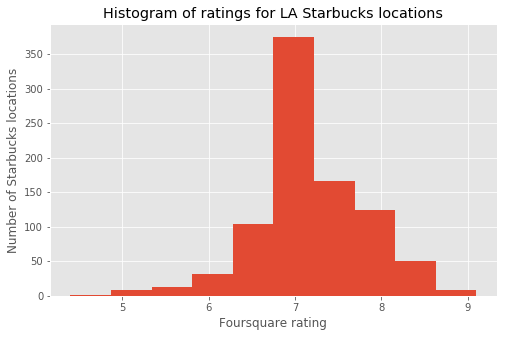

In [42]:
starbucks_master_04['rating'].plot(kind='hist', figsize=(8, 5))

plt.title('Histogram of ratings for LA Starbucks locations') # add a title to the histogram
plt.ylabel('Number of Starbucks locations') # add y-label
plt.xlabel('Foursquare rating') # add x-label

plt.show()

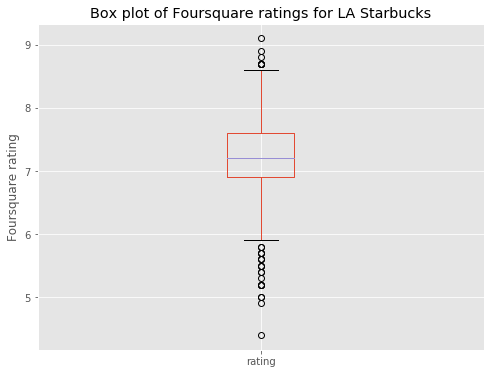

In [43]:
starbucks_master_04['rating'].plot(kind='box', figsize=(8, 6))

plt.title('Box plot of Foursquare ratings for LA Starbucks')
plt.ylabel('Foursquare rating')

plt.show()

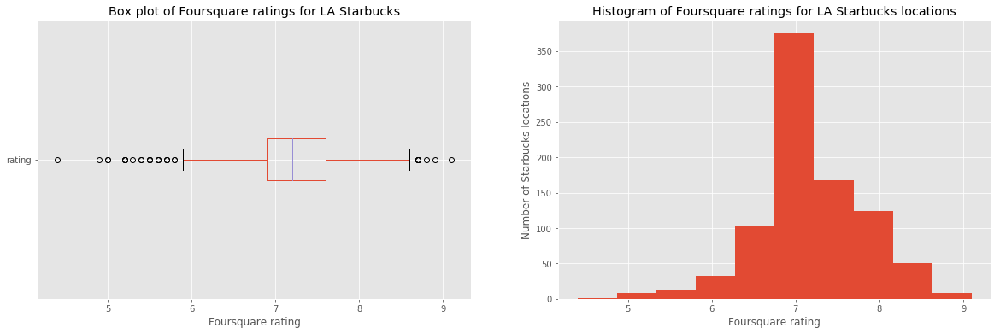

In [44]:
fig = plt.figure() # create figure

ax0 = fig.add_subplot(1, 2, 1) # add subplot 1 (1 row, 2 columns, first plot)
ax1 = fig.add_subplot(1, 2, 2) # add subplot 2 (1 row, 2 columns, second plot). See tip below**

# Subplot 1: Box plot
starbucks_master_04['rating'].plot(kind='box', figsize=(20, 6), vert = False, ax=ax0)
ax0.set_title('Box plot of Foursquare ratings for LA Starbucks')
ax0.set_xlabel('Foursquare rating')

# Subplot 2: Histogram
starbucks_master_04['rating'].plot(kind='hist', figsize=(20, 6), ax=ax1)
ax1.set_title ('Histogram of Foursquare ratings for LA Starbucks locations')
ax1.set_ylabel('Number of Starbucks locations')
ax1.set_xlabel('Foursquare rating')

plt.show()

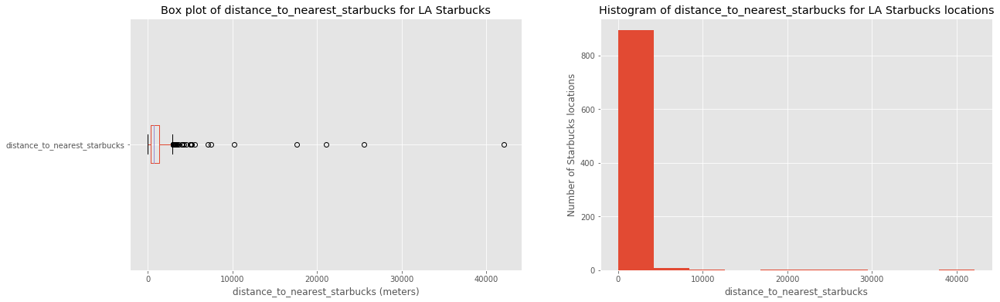

In [45]:
fig = plt.figure() # create figure

ax0 = fig.add_subplot(1, 2, 1) # add subplot 1 (1 row, 2 columns, first plot)
ax1 = fig.add_subplot(1, 2, 2) # add subplot 2 (1 row, 2 columns, second plot). See tip below**

# Subplot 1: Box plot
starbucks_master_04['distance_to_nearest_starbucks'].plot(kind='box', figsize=(20, 6), vert = False, ax=ax0)
ax0.set_title('Box plot of distance_to_nearest_starbucks for LA Starbucks')
ax0.set_xlabel('distance_to_nearest_starbucks (meters)')

# Subplot 2: Histogram
starbucks_master_04['distance_to_nearest_starbucks'].plot(kind='hist', figsize=(20, 6), ax=ax1)
ax1.set_title ('Histogram of distance_to_nearest_starbucks for LA Starbucks locations')
ax1.set_ylabel('Number of Starbucks locations')
ax1.set_xlabel('distance_to_nearest_starbucks')

plt.show()

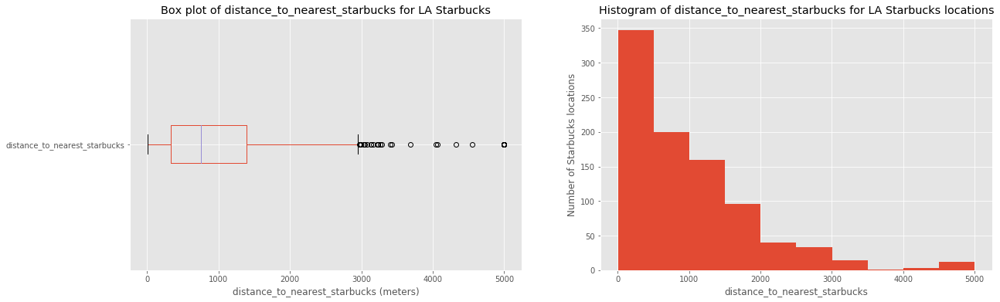

In [46]:
# Treat outliers for distance_to_nearest_starbucks by setting max distance = 5000 meters (about 3 miles)
starbucks_master_04.loc[(starbucks_master_04['distance_to_nearest_starbucks'] > 5000),'distance_to_nearest_starbucks'] = 5000

fig = plt.figure() # create figure

ax0 = fig.add_subplot(1, 2, 1) # add subplot 1 (1 row, 2 columns, first plot)
ax1 = fig.add_subplot(1, 2, 2) # add subplot 2 (1 row, 2 columns, second plot). See tip below**

# Subplot 1: Box plot
starbucks_master_04['distance_to_nearest_starbucks'].plot(kind='box', figsize=(20, 6), vert = False, ax=ax0)
ax0.set_title('Box plot of distance_to_nearest_starbucks for LA Starbucks')
ax0.set_xlabel('distance_to_nearest_starbucks (meters)')

# Subplot 2: Histogram
starbucks_master_04['distance_to_nearest_starbucks'].plot(kind='hist', figsize=(20, 6), ax=ax1)
ax1.set_title ('Histogram of distance_to_nearest_starbucks for LA Starbucks locations')
ax1.set_ylabel('Number of Starbucks locations')
ax1.set_xlabel('distance_to_nearest_starbucks')

plt.show()

In [47]:
import seaborn as sns

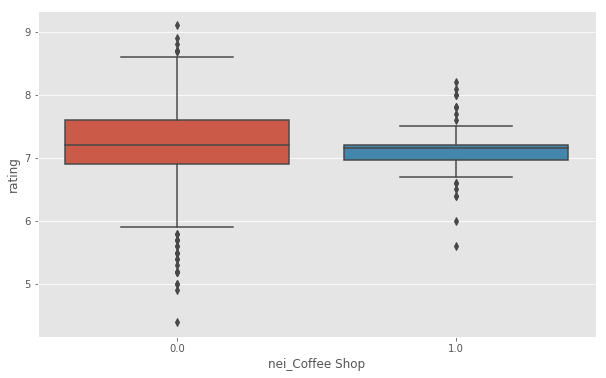

In [48]:
# plot
plt.figure(figsize=(10,6))
sns.boxplot(
    data=starbucks_master_04,
    x='nei_Coffee Shop',
    y='rating')

In [49]:
starbucks_master_04[["att_Private Lot","rating"]].corr()

,att_Private Lot,rating
att_Private Lot,1.000000,-0.031877
rating,-0.031877,1.000000


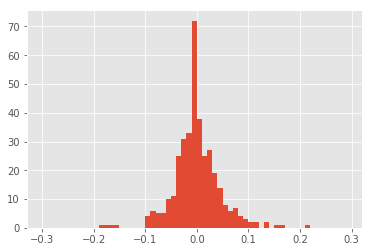

In [50]:
rating_corr = starbucks_master_04.drop(['price.tier','id','address','city','postalCode','name','attributes.groups','description','price.message','likes.count','photos.count','ratingSignals','stats.tipCount'],axis=1)
rating_corr = rating_corr.corr()['rating'][:].dropna()
rating_corr.sort_values(ascending=False).hist(bins=np.arange(-0.3,0.3,.01))

List of features sorted by pearson correlation descending

In [51]:
rating_corr.iloc[(-rating_corr.abs()).argsort()]

rating                                          1.000000
att_Outdoor Seating                             0.214619
nei_Airport Terminal                           -0.182852
nei_Airport Gate                               -0.171769
nei_Airport Lounge                             -0.169836
att_Breakfast                                   0.162572
distance_to_nearest_starbucks                   0.155781
nei_Border Crossing                            -0.152189
att_Wi-Fi                                       0.136664
att_Delivery                                    0.131360
nei_Gas Station                                 0.119872
nei_Dry Cleaner                                 0.116467
nei_Candy Store                                 0.108740
nei_Fast Food Restaurant                        0.100529
nei_South American Restaurant                  -0.097943
nei_Airport Service                            -0.096375
nei_Toy / Game Store                           -0.096375
nei_Big Box Store              

None of the categories have correlation > 0.215

In [53]:
starbucks_master_04[['distance_to_nearest_starbucks', 'rating']].corr()

,distance_to_nearest_starbucks,rating
distance_to_nearest_starbucks,1.000000,0.155781
rating,0.155781,1.000000


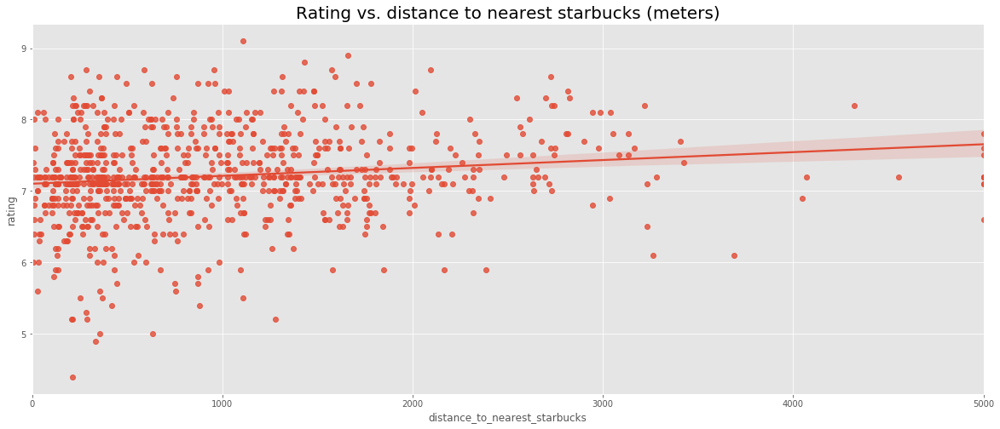

In [54]:
import seaborn as sns

#Plotting Regplot with Seaborn
plt.figure(figsize = (20,8))
x = starbucks_master_04['distance_to_nearest_starbucks']
y = starbucks_master_04['rating']
sns.regplot(x, y)
plt.title('Rating vs. distance to nearest starbucks (meters)', fontsize = 20)
plt.xlim([0, 5000])
plt.show()

Distance to nearest Starbucks has slightly positive correlation with rating.  Rating tends to be higher for Starbucks not as close to another Starbucks.

# Results <a id="20"></a>

## Create multiple regression model to predict rating <a id="22"></a>

In [55]:
starbucks_model_data = starbucks_master_04.dropna(subset=['rating'])

In [56]:
starbucks_model_data.describe()

,lat,lng,likes.count,photos.count,price.tier,rating,ratingSignals,stats.tipCount,nei_Accessories Store,nei_Acupuncturist,nei_Advertising Agency,nei_Airport,nei_Airport Gate,nei_Airport Lounge,nei_Airport Service,nei_Airport Terminal,nei_American Restaurant,nei_Arcade,nei_Art Gallery,nei_Art Museum,nei_Arts & Crafts Store,nei_Asian Restaurant,nei_Athletics & Sports,nei_Auditorium,nei_Auto Dealership,nei_Auto Garage,nei_Auto Workshop,nei_Automotive Shop,nei_BBQ Joint,nei_Bagel Shop,nei_Bakery,nei_Bank,nei_Bar,nei_Baseball Field,nei_Baseball Stadium,nei_Basketball Stadium,nei_Beach,nei_Beer Bar,nei_Big Box Store,nei_Bike Shop,nei_Board Shop,nei_Boarding House,nei_Boat or Ferry,nei_Bookstore,nei_Border Crossing,nei_Boutique,nei_Brazilian Restaurant,nei_Breakfast Spot,nei_Brewery,nei_Bridal Shop,nei_Bridge,nei_Buffet,nei_Building,nei_Burger Joint,nei_Bus Line,nei_Bus Station,nei_Bus Stop,nei_Business Center,nei_Business Service,nei_Butcher,nei_Cafeteria,nei_Café,nei_Cajun / Creole Restaurant,nei_Camera Store,nei_Candy Store,nei_Car Wash,nei_Casino,nei_Cemetery,nei_Check Cashing Service,nei_Cheese Shop,nei_Chinese Restaurant,nei_Chiropractor,nei_Church,nei_City Hall,nei_Clothing Store,nei_Cocktail Bar,nei_Coffee Shop,nei_College Academic Building,nei_College Administrative Building,nei_College Auditorium,nei_College Baseball Diamond,nei_College Basketball Court,nei_College Bookstore,nei_College Cafeteria,nei_College Classroom,nei_College Engineering Building,nei_College Gym,nei_College Lab,nei_College Library,nei_College Quad,nei_College Rec Center,nei_College Residence Hall,nei_College Science Building,nei_College Theater,nei_Comfort Food Restaurant,nei_Comic Shop,nei_Community College,nei_Concert Hall,nei_Conference Room,nei_Construction & Landscaping,nei_Convenience Store,nei_Convention Center,nei_Corporate Cafeteria,nei_Corporate Coffee Shop,nei_Cosmetics Shop,nei_Courthouse,nei_Coworking Space,nei_Credit Union,nei_Cruise,nei_Cultural Center,nei_Cycle Studio,nei_Dance Studio,nei_Daycare,nei_Deli / Bodega,nei_Dentist's Office,nei_Department Store,nei_Design Studio,nei_Dessert Shop,nei_Diner,nei_Discount Store,nei_Dive Bar,nei_Doctor's Office,nei_Dog Run,nei_Donburi Restaurant,nei_Doner Restaurant,nei_Donut Shop,nei_Dry Cleaner,nei_Dumpling Restaurant,nei_EV Charging Station,nei_Electronics Store,nei_Elementary School,nei_Emergency Room,nei_Event Space,nei_Eye Doctor,nei_Fabric Shop,nei_Farm,nei_Farmers Market,nei_Fast Food Restaurant,nei_Filipino Restaurant,nei_Film Studio,nei_Financial or Legal Service,nei_Fire Station,nei_Flea Market,nei_Flower Shop,nei_Food,nei_Food & Drink Shop,nei_Food Court,nei_Food Stand,nei_Food Truck,nei_Fountain,nei_Fraternity House,nei_French Restaurant,nei_Fried Chicken Joint,nei_Frozen Yogurt Shop,nei_Furniture / Home Store,nei_Garden,nei_Garden Center,nei_Gas Station,nei_Gastropub,nei_General College & University,nei_General Entertainment,nei_General Travel,nei_Gift Shop,nei_Golf Course,nei_Government Building,nei_Greek Restaurant,nei_Grocery Store,nei_Gym,nei_Gym / Fitness Center,nei_Gymnastics Gym,nei_Halal Restaurant,nei_Hardware Store,nei_Hawaiian Restaurant,nei_Health & Beauty Service,nei_Health Food Store,nei_Heliport,nei_High School,nei_Historic Site,nei_Hobby Shop,nei_Home Service,nei_Hospital,nei_Hostel,nei_Hot Dog Joint,nei_Hotel,nei_Hotel Bar,nei_Hotel Pool,nei_Housing Development,nei_Ice Cream Shop,nei_Indian Restaurant,nei_Intersection,nei_Irish Pub,nei_Island,nei_Italian Restaurant,nei_Japanese Restaurant,nei_Jewelry Store,nei_Juice Bar,nei_Kids Store,nei_Kitchen Supply Store,nei_Korean Restaurant,nei_Laboratory,nei_Lake,nei_Latin American Restaurant,nei_Laundry Service,nei_Lawyer,nei_Library,nei_Light Rail Station,nei_Lighting Store,nei_Lingerie Store,nei_Liquor Store,nei_Locksmith,nei_Lounge,nei_Market,nei_Martial Arts Dojo,nei_Massage Studio,nei_Maternity Clinic,nei_Medical Center,nei_Medical Lab,nei_Medical School,nei_Mediterranean Restaurant,nei_Meeting Room,nei_Men's Store,nei_Me

In [57]:
starbucks_model_data.shape

(882, 408)

In [58]:
y_data = starbucks_model_data['rating']

In [59]:
x_data_full = starbucks_model_data.drop(['price.tier','id','address','city','postalCode','name','attributes.groups','description','price.message','likes.count','photos.count','rating','ratingSignals','stats.tipCount'],axis=1)

In [60]:
x_data_full.head()

,lat,lng,nei_Accessories Store,nei_Acupuncturist,nei_Advertising Agency,nei_Airport,nei_Airport Gate,nei_Airport Lounge,nei_Airport Service,nei_Airport Terminal,nei_American Restaurant,nei_Arcade,nei_Art Gallery,nei_Art Museum,nei_Arts & Crafts Store,nei_Asian Restaurant,nei_Athletics & Sports,nei_Auditorium,nei_Auto Dealership,nei_Auto Garage,nei_Auto Workshop,nei_Automotive Shop,nei_BBQ Joint,nei_Bagel Shop,nei_Bakery,nei_Bank,nei_Bar,nei_Baseball Field,nei_Baseball Stadium,nei_Basketball Stadium,nei_Beach,nei_Beer Bar,nei_Big Box Store,nei_Bike Shop,nei_Board Shop,nei_Boarding House,nei_Boat or Ferry,nei_Bookstore,nei_Border Crossing,nei_Boutique,nei_Brazilian Restaurant,nei_Breakfast Spot,nei_Brewery,nei_Bridal Shop,nei_Bridge,nei_Buffet,nei_Building,nei_Burger Joint,nei_Bus Line,nei_Bus Station,nei_Bus Stop,nei_Business Center,nei_Business Service,nei_Butcher,nei_Cafeteria,nei_Café,nei_Cajun / Creole Restaurant,nei_Camera Store,nei_Candy Store,nei_Car Wash,nei_Casino,nei_Cemetery,nei_Check Cashing Service,nei_Cheese Shop,nei_Chinese Restaurant,nei_Chiropractor,nei_Church,nei_City Hall,nei_Clothing Store,nei_Cocktail Bar,nei_Coffee Shop,nei_College Academic Building,nei_College Administrative Building,nei_College Auditorium,nei_College Baseball Diamond,nei_College Basketball Court,nei_College Bookstore,nei_College Cafeteria,nei_College Classroom,nei_College Engineering Building,nei_College Gym,nei_College Lab,nei_College Library,nei_College Quad,nei_College Rec Center,nei_College Residence Hall,nei_College Science Building,nei_College Theater,nei_Comfort Food Restaurant,nei_Comic Shop,nei_Community College,nei_Concert Hall,nei_Conference Room,nei_Construction & Landscaping,nei_Convenience Store,nei_Convention Center,nei_Corporate Cafeteria,nei_Corporate Coffee Shop,nei_Cosmetics Shop,nei_Courthouse,nei_Coworking Space,nei_Credit Union,nei_Cruise,nei_Cultural Center,nei_Cycle Studio,nei_Dance Studio,nei_Daycare,nei_Deli / Bodega,nei_Dentist's Office,nei_Department Store,nei_Design Studio,nei_Dessert Shop,nei_Diner,nei_Discount Store,nei_Dive Bar,nei_Doctor's Office,nei_Dog Run,nei_Donburi Restaurant,nei_Doner Restaurant,nei_Donut Shop,nei_Dry Cleaner,nei_Dumpling Restaurant,nei_EV Charging Station,nei_Electronics Store,nei_Elementary School,nei_Emergency Room,nei_Event Space,nei_Eye Doctor,nei_Fabric Shop,nei_Farm,nei_Farmers Market,nei_Fast Food Restaurant,nei_Filipino Restaurant,nei_Film Studio,nei_Financial or Legal Service,nei_Fire Station,nei_Flea Market,nei_Flower Shop,nei_Food,nei_Food & Drink Shop,nei_Food Court,nei_Food Stand,nei_Food Truck,nei_Fountain,nei_Fraternity House,nei_French Restaurant,nei_Fried Chicken Joint,nei_Frozen Yogurt Shop,nei_Furniture / Home Store,nei_Garden,nei_Garden Center,nei_Gas Station,nei_Gastropub,nei_General College & University,nei_General Entertainment,nei_General Travel,nei_Gift Shop,nei_Golf Course,nei_Government Building,nei_Greek Restaurant,nei_Grocery Store,nei_Gym,nei_Gym / Fitness Center,nei_Gymnastics Gym,nei_Halal Restaurant,nei_Hardware Store,nei_Hawaiian Restaurant,nei_Health & Beauty Service,nei_Health Food Store,nei_Heliport,nei_High School,nei_Historic Site,nei_Hobby Shop,nei_Home Service,nei_Hospital,nei_Hostel,nei_Hot Dog Joint,nei_Hotel,nei_Hotel Bar,nei_Hotel Pool,nei_Housing Development,nei_Ice Cream Shop,nei_Indian Restaurant,nei_Intersection,nei_Irish Pub,nei_Island,nei_Italian Restaurant,nei_Japanese Restaurant,nei_Jewelry Store,nei_Juice Bar,nei_Kids Store,nei_Kitchen Supply Store,nei_Korean Restaurant,nei_Laboratory,nei_Lake,nei_Latin American Restaurant,nei_Laundry Service,nei_Lawyer,nei_Library,nei_Light Rail Station,nei_Lighting Store,nei_Lingerie Store,nei_Liquor Store,nei_Locksmith,nei_Lounge,nei_Market,nei_Martial Arts Dojo,nei_Massage Studio,nei_Maternity Clinic,nei_Medical Center,nei_Medical Lab,nei_Medical School,nei_Mediterranean Restaurant,nei_Meeting Room,nei_Men's Store,nei_Metro Station,nei_Mexican Restaurant,nei_Middle Eastern Restaurant,nei_Mil

In [61]:
from sklearn.model_selection import train_test_split

x_train_full, x_test_full, y_train, y_test = train_test_split(x_data_full, y_data, test_size=0.20, random_state=2)

print("number of test samples :", x_test_full.shape[0])
print("number of training samples:",x_train_full.shape[0])


number of test samples : 177
number of training samples: 705


In [62]:
# Replace missing distance_to_nearest_starbucks with average value separately for train/test
x_train_full['distance_to_nearest_starbucks'].fillna((x_train_full['distance_to_nearest_starbucks'].mean()), inplace=True)
x_test_full['distance_to_nearest_starbucks'].fillna((x_test_full['distance_to_nearest_starbucks'].mean()), inplace=True)

/opt/conda/envs/Python36/lib/python3.6/site-packages/pandas/core/generic.py:6130: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._update_inplace(new_data)


In [63]:
from sklearn.linear_model import LinearRegression
lm = LinearRegression()
lm

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

### Model 1 (all features)

In [64]:
# Model 1
lm.fit(x_train_full, y_train)
print('train score = ',lm.score(x_train_full, y_train))
print('test score = ',lm.score(x_test_full, y_test))
lm.coef_

train score =  0.5501846893084423
test score =  -2350545429075966.0


array([ 1.83652596e-01,  1.88750172e-01, -1.73330244e-01, -6.78880047e-01,
        1.38184748e-01,  2.61726120e+09,  3.26634804e+08, -1.38040641e+08,
       -1.08259450e+00,  3.48294854e-01,  1.02456167e-01, -6.45894065e-01,
       -7.33542183e-01,  3.67735869e+07,  1.38887018e-01, -5.80962393e-02,
        5.45236893e-01,  3.66741536e+06,  2.61286125e-02,  3.18773045e+05,
       -1.89123902e-01,  9.43954587e-02, -6.35816893e-02,  5.75234532e-01,
        1.81499362e-01,  1.00371003e-01,  1.67872235e-01,  2.83210009e-01,
        1.96264780e+00,  1.20787440e+06,  3.42963405e-01,  1.12546552e-01,
       -1.97218530e-01, -7.09431767e-02, -9.08445865e-01,  3.67470987e-01,
        1.54515528e+05, -9.11466479e-02, -1.88594165e+08, -4.33453589e+05,
       -1.02436616e+00, -9.16094970e-01,  8.87836516e-03,  2.87846925e+05,
       -3.38688260e-01, -2.19361484e-03,  2.54066885e-02,  1.34822309e-01,
        2.03054547e-02, -2.96182451e+00, -4.33452608e+05,  4.75101773e-01,
       -4.31977823e-01, -

R-squared over the train dataset is fairly high at 0.55, however the R-squared over the test dataset is extremely low.  Coefficients are not realistic magnitude.

### Model 2 (features with correlation >= 0.1)

In [65]:
# Model 2
x_data_cols = rating_corr.index[rating_corr.abs() >= 0.1].tolist()
x_data_cols.remove('rating')
x_data_cols

['nei_Airport Gate',
 'nei_Airport Lounge',
 'nei_Airport Terminal',
 'nei_Border Crossing',
 'nei_Candy Store',
 'nei_Dry Cleaner',
 'nei_Fast Food Restaurant',
 'nei_Gas Station',
 'att_Breakfast',
 'att_Delivery',
 'att_Outdoor Seating',
 'att_Wi-Fi',
 'distance_to_nearest_starbucks']

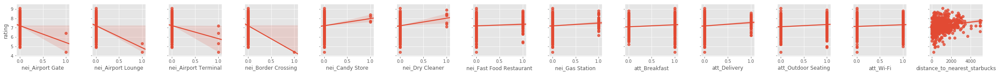

In [66]:
x_y_train_full = pd.concat([x_train_full,y_train],axis=1)
sns.pairplot(x_y_train_full,x_vars=x_data_cols,y_vars='rating',kind='reg')

In [67]:
x_train = x_train_full[x_data_cols]
x_test = x_test_full[x_data_cols]
print('x_train shape=',x_train.shape)
print('y_train shape=',y_train.shape)
lm.fit(x_train, y_train)
print('train score = ',lm.score(x_train, y_train))
print('test score = ',lm.score(x_test, y_test))
lm.coef_

x_train shape= (705, 13)
y_train shape= (705,)
train score =  0.17108021087741598
test score =  0.05720620782585972


array([-8.38127196e-01, -1.98672327e+00,  1.81444769e-01, -3.22553967e-02,
        6.69290807e-01,  7.51893807e-01,  1.04941149e-01,  2.49057752e-01,
        1.61549083e-01,  2.68822380e-01,  1.53690975e-01,  2.30479434e-02,
        9.45697164e-05])

R-squared is lower than model 1 for train dataset, but is much better over test dataset.

### Model 3 (features with correlation >= 0.05)

In [98]:
# Model 3
x_data_cols = rating_corr.index[rating_corr.abs() >= 0.05].tolist()
x_data_cols.remove('rating')
x_data_cols.remove('att_$$')
x_data_cols

['lat',
 'lng',
 'nei_Accessories Store',
 'nei_Airport Gate',
 'nei_Airport Lounge',
 'nei_Airport Service',
 'nei_Airport Terminal',
 'nei_Bagel Shop',
 'nei_Bakery',
 'nei_Big Box Store',
 'nei_Bookstore',
 'nei_Border Crossing',
 'nei_Bus Station',
 'nei_Candy Store',
 'nei_City Hall',
 'nei_Clothing Store',
 'nei_College Bookstore',
 'nei_College Library',
 'nei_College Residence Hall',
 'nei_College Theater',
 'nei_Cycle Studio',
 'nei_Diner',
 'nei_Discount Store',
 'nei_Dog Run',
 'nei_Dry Cleaner',
 'nei_Fast Food Restaurant',
 'nei_Fire Station',
 'nei_Food Court',
 'nei_Gas Station',
 'nei_Hotel',
 'nei_Ice Cream Shop',
 'nei_Juice Bar',
 'nei_Market',
 'nei_Medical Lab',
 'nei_Military Base',
 'nei_Mobile Phone Shop',
 'nei_Moving Target',
 'nei_New American Restaurant',
 'nei_Office',
 'nei_Peruvian Restaurant',
 'nei_Pool',
 'nei_Public Art',
 'nei_Ramen Restaurant',
 'nei_Rest Area',
 'nei_Restaurant',
 'nei_Sandwich Place',
 'nei_Smoothie Shop',
 'nei_South American Res

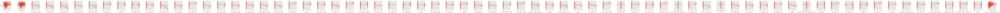

In [99]:
x_y_train_full = pd.concat([x_train_full,y_train],axis=1)
sns.pairplot(x_y_train_full,x_vars=x_data_cols,y_vars='rating',kind='reg')

In [100]:
x_train = x_train_full[x_data_cols]
x_test = x_test_full[x_data_cols]
print('x_train shape=',x_train.shape)
print('y_train shape=',y_train.shape)
lm.fit(x_train, y_train)
print('train score = ',lm.score(x_train, y_train))
print('test score = ',lm.score(x_test, y_test))
lm.coef_

x_train shape= (705, 70)
y_train shape= (705,)
train score =  0.33605530505640824
test score =  0.013352298539670904


array([ 2.05218752e-01,  7.20593425e-02,  1.99414100e-02,  9.47713412e-01,
       -1.60075000e+00, -1.69245107e+00,  8.36853688e-02, -1.23981466e-02,
        1.50603384e-01, -1.64175027e-01, -3.72077350e-01, -2.10321577e+00,
       -9.06955303e-01,  7.76956231e-01, -6.32157202e-01,  7.56678656e-02,
       -6.53015377e-01,  2.97923577e-01, -8.04227699e-01, -1.72410089e+00,
        6.10604500e-01,  1.07058010e-01,  8.65997104e-02, -7.36757887e-02,
        6.29547799e-01,  1.16089580e-01,  9.16832702e-02, -1.26809889e-01,
        2.45830270e-01, -1.21417751e-01,  2.81681389e-01, -9.07616467e-02,
        2.02069882e-01, -6.62076692e-01, -1.10725137e+00,  1.14243935e-01,
        9.27051133e-01, -1.13179569e-01, -1.35527958e-01, -1.23412136e+00,
       -4.55779107e-01, -4.97818650e-01,  2.84140463e-01, -1.02973186e-14,
        3.72922501e-01,  1.11088433e-02,  9.53753107e-01, -5.55111512e-17,
        3.06256916e-01, -1.94661050e+00,  0.00000000e+00, -5.99854880e-01,
       -4.61524543e-01, -

Adding more features than model 2 generated a higher R-squared over the train dataset, but slightly worse R-squared over the test dataset.

### Model 4 (features with correlation >= 0.15)

In [70]:
# Model 4
x_data_cols = rating_corr.index[rating_corr.abs() >= 0.15].tolist()
x_data_cols.remove('rating')
x_data_cols

['nei_Airport Gate',
 'nei_Airport Lounge',
 'nei_Airport Terminal',
 'nei_Border Crossing',
 'att_Breakfast',
 'att_Outdoor Seating',
 'distance_to_nearest_starbucks']

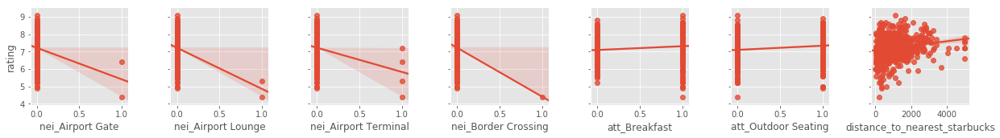

In [97]:
x_y_train_full = pd.concat([x_train_full,y_train],axis=1)
sns.pairplot(x_y_train_full,x_vars=x_data_cols,y_vars='rating',kind='reg')

In [72]:
x_train = x_train_full[x_data_cols]
x_test = x_test_full[x_data_cols]
print('x_train shape=',x_train.shape)
print('y_train shape=',y_train.shape)
lm.fit(x_train, y_train)
print('train score = ',lm.score(x_train, y_train))
print('test score = ',lm.score(x_test, y_test))
lm.coef_

x_train shape= (705, 7)
y_train shape= (705,)
train score =  0.12479538184440099
test score =  0.003789528032455691


array([-9.71593819e-01, -2.10218590e+00,  2.57337607e-01,  7.94602883e-02,
        1.93723199e-01,  1.65592894e-01,  1.13240569e-04])

Using only features with highest correlation with rating produced results slightly worse than model 2 over both the train and test datasets.

# Discussion <a id="24"></a>

## Model summary <a id="26"></a>

| Model # | R-squared for TRAIN | R-squared for TEST |
| --- | ---:| ---:|
| 1 | 0.550 | -2.35 x 10^16 | 
| 2 | 0.171 | 0.057 |
| 3 | 0.336 | 0.013 |
| 4 | 0.125 | 0.004 |

## Observations <a id="28"></a>
The features explored in this report (store attributes, neighbor venue categories, and distance to nearest Starbucks) turned out to be poor out-of-sample predictors for Foursquare ratings at LA Starbucks.  Linear correlation was not very high with respect to Foursquare rating for any of the features individually (all < 0.22), and when tested in combination using linear regression, the R-squared values over the test dataset were all < 0.06 showing weak prediction capability.

# Conclusion <a id="30"></a>

## Recommendations <a id="32"></a>
For Starbucks owners:
- Consider adding the following services based on high positive correlation with Foursquare rating:
 - Outdoor seating
 - Breakfast
 - Wi-fi
 - Delivery
 - Private parking lot  

- Remove the following attributes due to strong negative correlation with Foursquare rating:
 - ATMs
 - TVs  

For a potential new Starbucks owner in LA:
- Avoid locating near transportation sites as they tend to have strong negative correlation with Foursquare rating
 - Airports (terminals, gates, lounges, and border crossings)
 - Bus stations
 - Train stations
- Avoid locating on college campuses near the following location types as they tend to have lower Foursquare ratings:
 - College theater, library, bookstore, residence halls
 - University


## Further Analysis <a id="34"></a>

Consider additional venue attributes to find features that may be more predictive of Foursquare rating:
- Store cleanliness
- Staff friendliness
- Average wait times
 - Store staffing levels
 - Customer volume

Analyze tips and user comments to find common attributes for stores that are rated very high/low